# Libraries importation and sound file creation

In [64]:
%matplotlib inline
# Importing necessary libraries
import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
import soundfile as sf
import scipy.signal as sig
import sympy as sym
import IPython.display as ipd
import warnings
warnings.filterwarnings("ignore") #para ingnorar warnings de operaciones con números complejos.
from scipy.signal import spectrogram

In [2]:
!pip install soundfile #instala libreria externa soundfile, sirve para convertir auido en vector

In [3]:
!python3 -m pip install --force-reinstall https://github.com/yt-dlp/yt-dlp/archive/master.tar.gz #algoritmo para subir audios de yt

     - 2.7 MB 13.0 MB/s 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for yt-dlp: filename=yt_dlp-2025.1.26-py3-none-any.whl size=2928034 sha256=971d57be2db0cdae24a9ff092110ed29e8bb8c568b59c83e4e899c1c0e173a88
  Stored in directory: /tmp/pip-ephem-wheel-cache-kny1vqf8/wheels/2d/79/97/7209650ef73114e0fe0603480da012ad3afacb9cae6b8acd9a
Successfully built yt-dlp


In [4]:
link="https://www.youtube.com/watch?v=BuMBmK5uksg&ab_channel=TheGameVEVO"
!yt-dlp --extract-audio -o "audio" --audio-format mp3 {link}

[youtube] Extracting URL: https://www.youtube.com/watch?v=BuMBmK5uksg
[youtube] BuMBmK5uksg: Downloading webpage
[youtube] BuMBmK5uksg: Downloading tv client config
[youtube] BuMBmK5uksg: Downloading player 1080ef44
[youtube] BuMBmK5uksg: Downloading tv player API JSON
[youtube] BuMBmK5uksg: Downloading ios player API JSON
[youtube] BuMBmK5uksg: Downloading m3u8 information
[info] BuMBmK5uksg: Downloading 1 format(s): 251
[download] Destination: audio
[download] 100% of    3.45MiB in 00:00:00 at 24.77MiB/s
[ExtractAudio] Destination: audio.mp3
Deleting original file audio (pass -k to keep)


In [5]:
!ffmpeg -y -i audio.mp3 output.wav # Convierte el archivo audio.mp3 a formato WAV y lo guarda como output.wav

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [6]:
nombre_aud = "output.wav"  # Define el nombre del archivo de audio de salida como "output.wav"
x, fs = sf.read(nombre_aud) # Lee el archivo de audio y guarda los datos en 'x' y la frecuencia de muestreo en 'fs'
print('Frecuencia de muestreo %.2f[Hz]\naudio %s' % (fs,nombre_aud)) # Imprime la frecuencia de muestreo y el nombre del archivo

Frecuencia de muestreo 48000.00[Hz]
audio output.wav


In [7]:
def RC_filter(R_v, C_v, t, input_signal): # Parámetros: resistencia, capacitancia, tiempo y señal de entrada

    # Define symbolic variables
    s = sym.symbols('s')
    R = sym.symbols('R', positive=True)
    C = sym.symbols('C', positive=True)

    # Transfer function H(s) = 1 / (1 + sRC)
    H = 1 / (1 + s * R * C)

    num, den = sym.fraction(H)

    num_coeffs = sym.Poly(num, s).all_coeffs()
    den_coeffs = sym.Poly(den, s).all_coeffs() #Poly() Genera un polinomio a partir de una expresión, lo usamos para acceder a all_coeffs(). Genera una lista de listas con los coeficientes

    num_coeffs_num = []
    for coeff in num_coeffs:
        coeff_num = float(coeff.subs({R: R_v, C: C_v})) #Intercambiar las variables simbólicas por los valores numéricos
        num_coeffs_num.append(coeff_num)

    den_coeffs_num = []
    for coeff in den_coeffs:
        coeff_num = float(coeff.subs({R: R_v, C: C_v}))
        den_coeffs_num.append(coeff_num)

    # Crear el sistema LTI
    system = sig.lti(num_coeffs_num, den_coeffs_num)

    # Simular la respuesta del sistema a la señal de entrada
    return sig.lsim(system, input_signal, t)

def RC_filter_fc(fc, t, input_signal):
    R_v = 1000 #Suponiendo R estática 1000 ohmios
    C_v =  1/(2*np.pi*fc*R_v)
    return RC_filter(R_v, C_v, t, input_signal)

In [8]:
def rc_lowpass(f, fc):
    return 1 / np.sqrt(1 + (f / fc) ** 2)

def rl_highpass(f, fc):
    return f / np.sqrt(f**2 + fc**2)

def rlc_bandpass(f, fc1, fc2):
    return (f / fc1) * (1 / np.sqrt(1 + (f / fc1)**2)) * (fc2 / np.sqrt(f**2 + fc2**2))

In [9]:
# Función para calcular la respuesta del filtro pasa bajas RC
def filtro_rc(frecuencia_corte, resistencia, frecuencia):
    capacitancia = 1 / (2 * np.pi * resistencia * frecuencia_corte)
    H = 1 / (1 + 1j * 2 * np.pi * frecuencia * resistencia * capacitancia)
    return H, capacitancia

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='tiempo'):
    # Calculate H based on the signal's frequency range
    # Use the length of the current signal to determine the appropriate frequency range
    num_muestras_signal = len(signal)
    H, capacitancia = filtro_rc(frecuencia_corte, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        # Transformada de Fourier para señales en tiempo
        signal_frecuencia = np.fft.fft(signal)
        # Apply the filter to the signal's frequency representation
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, capacitancia
    elif dominio == 'frecuencia':
        # Señales ya en frecuencia
        # Apply the filter to the signal's frequency representation
        signal_filtrada = signal * H
        return signal_filtrada, H, capacitancia

In [10]:
# Función para visualizar el espectrograma de una lista de señales
def visualizar_espectrogramas(señales, frecuencia_muestreo, títulos):
    plt.figure(figsize=(12, len(señales) * 4))

    for i, señal in enumerate(señales):
        # Cálculo del espectrograma
        f, t, Sxx = sig.spectrogram(señal, fs=frecuencia_muestreo, nperseg=256, noverlap=128, scaling='density')

        # Visualización del espectrograma
        plt.subplot(len(señales), 1, i + 1)
        plt.pcolormesh(t, f, 10 * np.log10(Sxx), shading='gouraud')
        plt.colorbar(label='Densidad espectral (dB)')
        plt.title(títulos[i])
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Frecuencia (Hz)')
        plt.ylim(0, frecuencia_muestreo / 2)

    plt.tight_layout()
    plt.show()

In [11]:
x_mono = np.mean(x, axis=1) # elimina uno de los canales de la pista de audio.

In [12]:
ns = 60 #se reproducen los primeros ns segundos
ipd.Audio(x_mono[:int(fs*ns)].T,rate=fs)

In [13]:
xx = x_mono.copy() #copiar archivos para procesar
ti = 19 #tiempo incio a procesar seg
tf = 24 #tiempo final a procesar seg
#esto se hace con el objetivo de que el procesado sea más sencillo, más rápido y consuma menos recursos
xc = xx[int(ti*fs):int((tf*fs))] #recortado del audio original

vt = np.arange(ti,tf,1/fs) # vector de tiempo. Nos servirá para plotear las señales más adelante

In [14]:
ipd.Audio(xc[:int(fs*ns)].T,rate=fs) #reproducción del audio recortado, en el intervalo de tiempo definido

# Modulation and signal filtering

In [15]:
Xwc = np.fft.rfft(xc,norm="forward") # axis=0 permite aplicar fft por cada columna de xpro
#Xwc1 = np.fft.rfft(xs[:,0])
#Xwc2 = np.fft.rfft(xs[:,1])
vf = np.fft.rfftfreq(np.size(xc,0),1/fs) #se crea el vector de frecuencias, de igual manera fungirá más adelante.

In [16]:
#filtrar espectro
fc = 800 #frecuencia de corte
tout, xf, xout = RC_filter_fc(fc, vt, xc)
ipd.Audio(xf.T, rate=fs)

In [17]:
Xfw = np.fft.rfft(xf, norm="forward") #Aplicamos transformada de Fourier a la señal filtrada yout

In [18]:
#construcción de onda cos.
Fo = 5000 #Fundamental cos
Fs = 500
A = 1 #amplitud
xt = A*np.cos(2*np.pi*Fo*vt) #+ A*np.cos(2*np.pi*Fs*vt) #coseno

In [19]:
Xwcos = np.fft.rfft(xt,norm="forward") # fft del cos

In [20]:
dx = xf * xt

In [21]:
ipd.Audio(dx[:int(fs*ns)].T,rate=fs) #pista de audio desplazada

In [22]:
dxw = np.fft.rfft(dx,axis=0) #ftt de la señal desplazada

In [23]:
dx2 = dx * xt #desplazamiento para la reconversión de la señal.

In [24]:
ipd.Audio(dx2[:int(fs*ns)].T,rate=fs) #Audio desplazado con audio original.

In [25]:
dxw2 = np.fft.rfft(dx2,axis=0,norm="forward") #ftt para la señal de reconversión

In [26]:
fcs = 800 #frecuencia de corte
# The stages argument should be passed to RC_filter, not RC_filter_fc
# Assuming you want to filter dx2 with a cutoff frequency of fcs and use vt as the time vector:
R_v = 1000  # Assuming R is static at 1000 ohms
C_v = 1 / (2 * np.pi * fcs * R_v)
# Call RC_filter directly with the stages argument
tout, dxf, xout = RC_filter(R_v, C_v, vt, dx2)

ipd.Audio(dxf.T, rate=fs)

In [27]:
dxwf = np.fft.rfft(dxf,axis=0) #ftt para la señal de reconversión

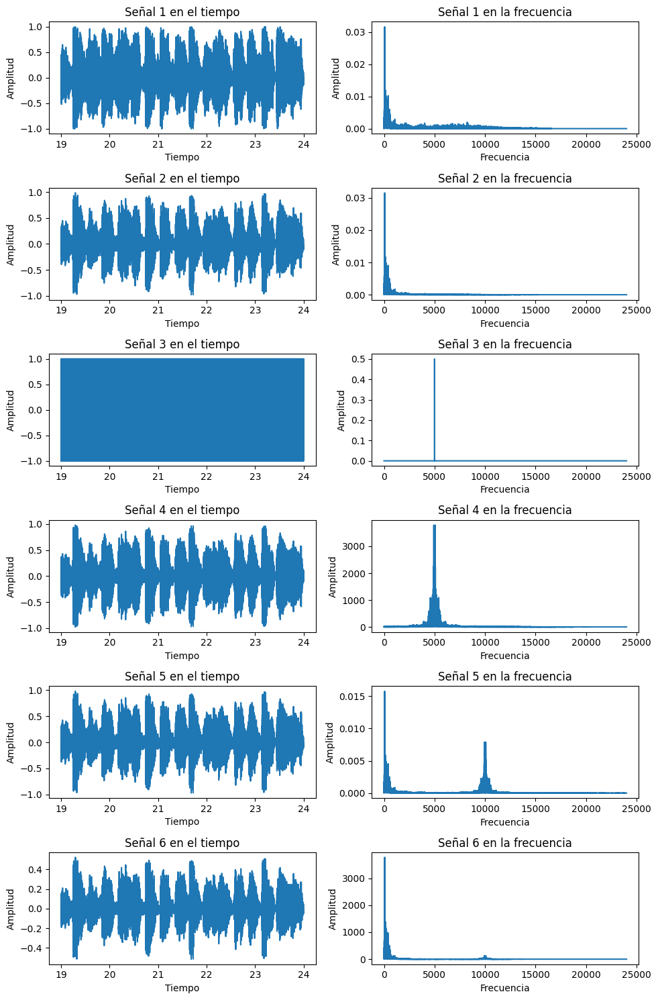

In [28]:
x_tiempo = [xc, xf, xt, dx, dx2, dxf]
x_frecuencia = [abs(Xwc), abs(Xfw), abs(Xwcos), abs(dxw), abs(dxw2), abs(dxwf)]

# Crear subplot
fig, axs = plt.subplots(6, 2, figsize=(10, 15))  # 6 filas, 2 columnas

# Gráficas en el dominio del tiempo (columna 0)
for i, xsig in enumerate(x_tiempo):
    axs[i, 0].plot(vt, xsig) # 'tiempo' debe estar definido previamente
    axs[i, 0].set_title(f'Señal {i + 1} en el tiempo')
    axs[i, 0].set_xlabel('Tiempo')
    axs[i, 0].set_ylabel('Amplitud')

# Gráficas en el dominio de la frecuencia (columna 1)
for i, xsig in enumerate(x_frecuencia):
    axs[i, 1].plot(vf, xsig) # 'frecuencia' debe estar definido previamente
    axs[i, 1].set_title(f'Señal {i + 1} en la frecuencia')
    axs[i, 1].set_xlabel('Frecuencia')
    axs[i, 1].set_ylabel('Amplitud')

# Ajustar el espaciado entre subplots
plt.tight_layout()

# Mostrar el subplot
plt.show()

# Spectogram Calibration

In [29]:
#construcción de onda cos.
Fo = 5000 #Fundamental cos
Fs = 500
A = 1 #amplitud
xt1 = A*np.cos(2*np.pi*Fo*vt) + A*np.cos(2*np.pi*Fs*vt)

No calibration

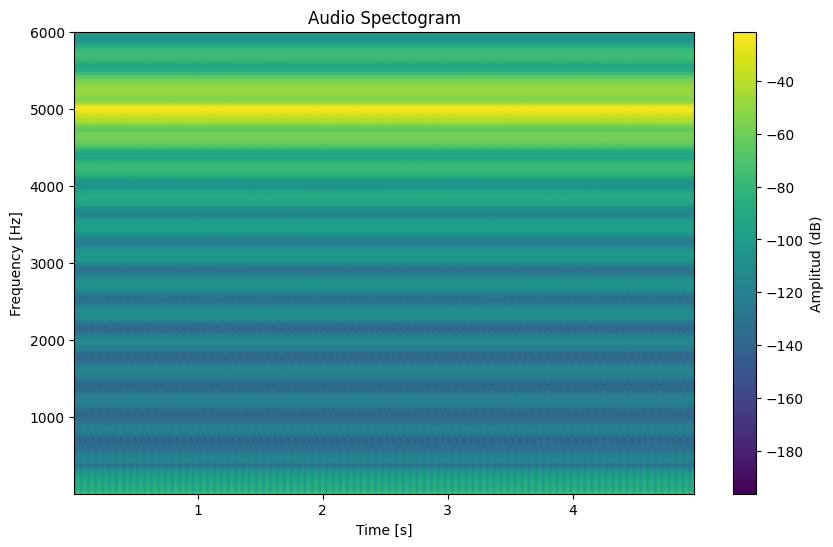

In [30]:
f, ts, Sxx = sig.spectrogram(xt, fs=fs, nperseg=1024)
plt.figure(figsize=(10, 6))
plt.pcolormesh(ts, f, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')  # Espectrograma en dB
plt.colorbar(label='Amplitud (dB)')
plt.title('Audio Spectogram')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [s]')
plt.ylim(1, 6000)  # Limitar a la mitad de la frecuencia de muestreo
plt.show()

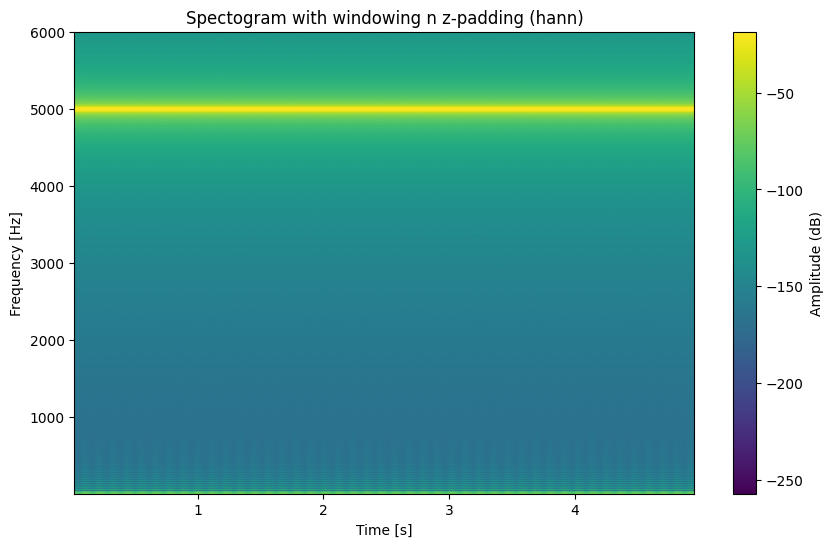

In [31]:
f, ts, Sxx = sig.spectrogram(xt, fs=fs, nperseg=2048, window='hann', nfft=4096)  # Usar ventana de Hann
plt.figure(figsize=(10, 6))
plt.pcolormesh(ts, f, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Amplitude (dB)')
plt.title('Spectogram with windowing n z-padding (hann)')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [s]')
plt.ylim(1, 6000)
plt.show()

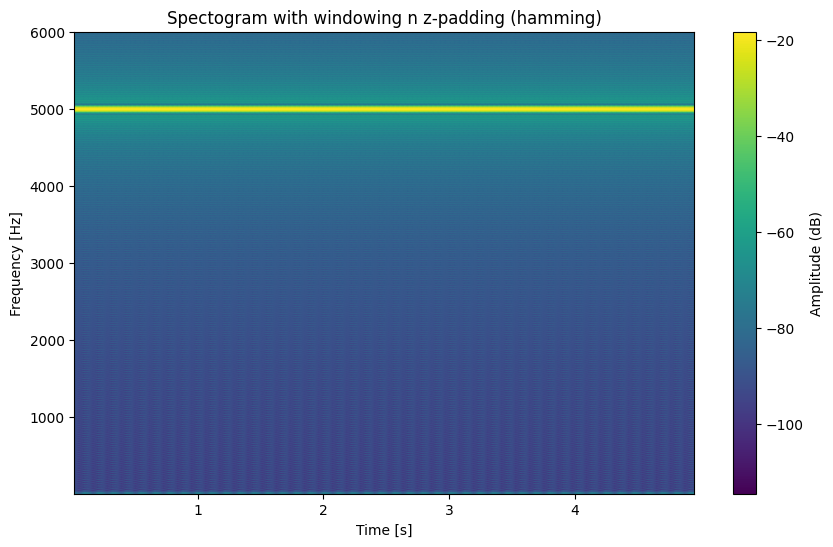

In [32]:
f, ts, Sxx = sig.spectrogram(xt, fs=fs, nperseg=2048, window='hamming', nfft=4096)  # Usar ventana de Hann
plt.figure(figsize=(10, 6))
plt.pcolormesh(ts, f, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Amplitude (dB)')
plt.title('Spectogram with windowing n z-padding (hamming)')
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [s]')
plt.ylim(1, 6000)
plt.show()

Log scale

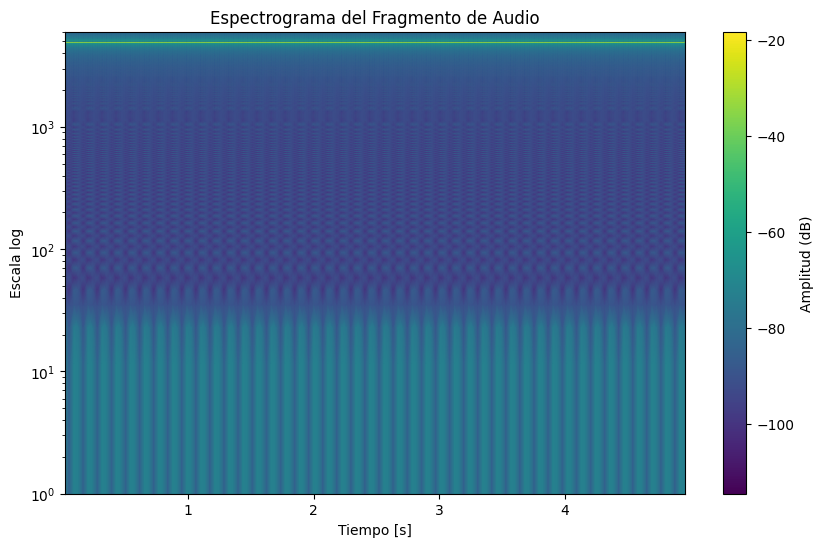

In [33]:
plt.figure(figsize=(10, 6))
plt.pcolormesh(ts, f, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Amplitud (dB)')
plt.title('Espectrograma del Fragmento de Audio')
plt.ylabel('Escala log')
plt.xlabel('Tiempo [s]')

# Cambiar la escala del eje y a logarítmica
plt.yscale("log")

plt.ylim(1, 6000)
plt.show()

# Sound file tone calibration

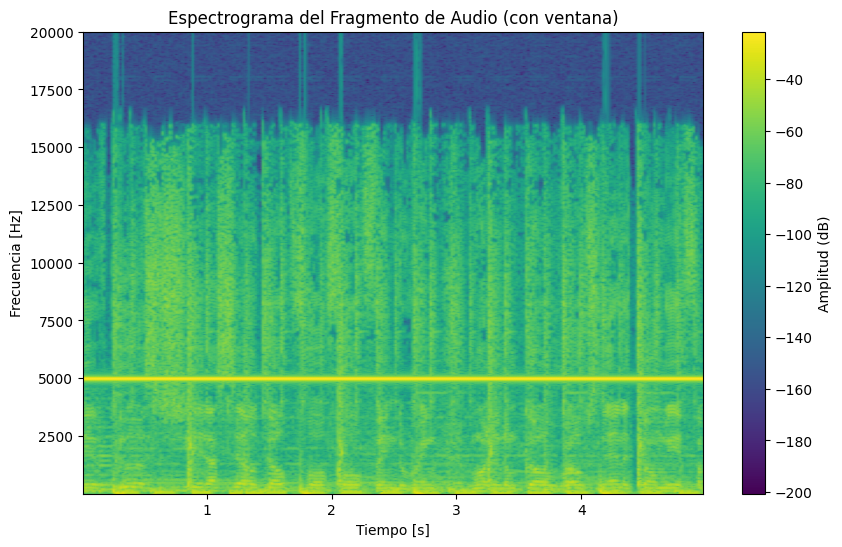

In [34]:
xt = np.cos(2*np.pi*Fo*vt)
xr = xt + 0.5*xc

f, ts, Sxx = sig.spectrogram(xr, fs=fs, nperseg=1024, window='hann', nfft = 2048)

plt.figure(figsize=(10, 6))
plt.pcolormesh(ts, f, 10 * np.log10(Sxx), shading='gouraud', cmap='viridis')
plt.colorbar(label='Amplitud (dB)')
plt.title('Espectrograma del Fragmento de Audio (con ventana)')
plt.ylabel('Frecuencia [Hz]')
plt.xlabel('Tiempo [s]')
plt.ylim(1, 20000)
plt.show()

# Filter response

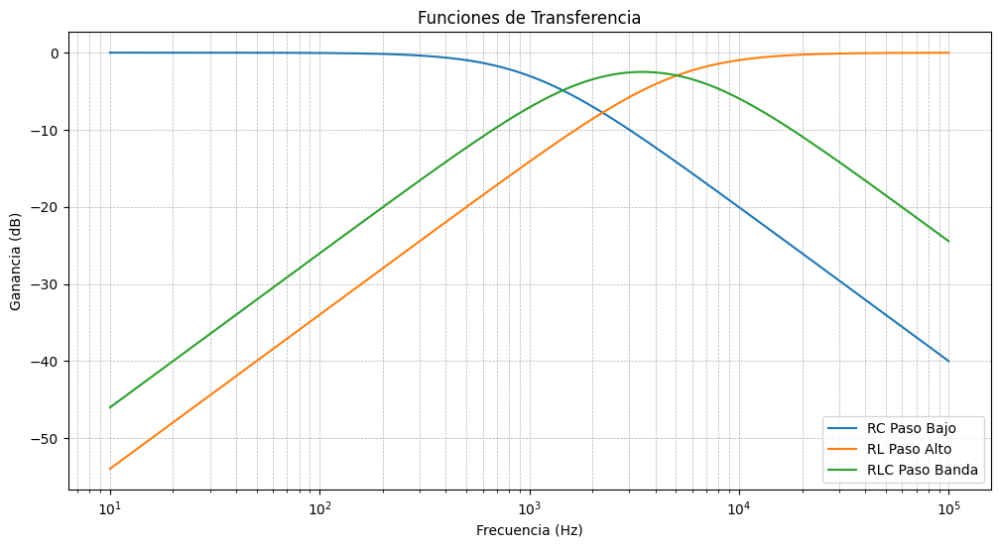

In [35]:

# Parámetros de la señal
t = np.linspace(0, 0.01, int(0.01 * Fs))  # Vector de tiempo (10 ms)

# Parámetros de los filtros
R = 1e3  # Resistencia en ohmios
C = 1e-9  # Capacitancia en faradios
L = 10e-3  # Inductancia en henrios

# Frecuencias de corte
fc_low = 1000  # Frecuencia de corte para paso bajo (Hz)
fc_high = 5000  # Frecuencia de corte para paso alto (Hz)
fc_band = [2000, 6000]  # Frecuencia de corte para paso banda (Hz)

# Filtros RC, RL y RLC (funciones de transferencia)


# Generación de frecuencias para análisis
frequencies = np.logspace(1, 5, 500)  # Rango de frecuencias (10 Hz - 100 kHz)

# Funciones de transferencia
h_rc_lp = rc_lowpass(frequencies, fc_low)
h_rl_hp = rl_highpass(frequencies, fc_high)
h_rlc_bp = rlc_bandpass(frequencies, fc_band[0], fc_band[1])

# Visualización de las funciones de transferencia
plt.figure(figsize=(12, 6))
plt.semilogx(frequencies, 20 * np.log10(h_rc_lp), label="RC Paso Bajo")
plt.semilogx(frequencies, 20 * np.log10(h_rl_hp), label="RL Paso Alto")
plt.semilogx(frequencies, 20 * np.log10(h_rlc_bp), label="RLC Paso Banda")
plt.title("Funciones de Transferencia")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Ganancia (dB)")
plt.grid(which="both", linestyle="--", linewidth=0.5)
plt.legend()
plt.show()

# Aplicación de filtros (respuesta en frecuencia)
# RC Paso Bajo
h_rc = rc_lowpass(Fo, fc_low)  # Ganancia en frecuencia Fo
yt_rc = xt * h_rc

# RL Paso Alto
h_rl = rl_highpass(Fo, fc_high)
yt_rl = xt * h_rl

# RLC Paso Banda
h_rlc = rlc_bandpass(Fo, fc_band[0], fc_band[1])
yt_rlc = xt * h_rlc

# Ventaneo y zero padding en los espectrogramas
window = sig.get_window("hamming", 1024)  # Ventana Hamming
nfft = 1024  # Zero padding (número de puntos FFT)

# RC filters

Low pass RC filter

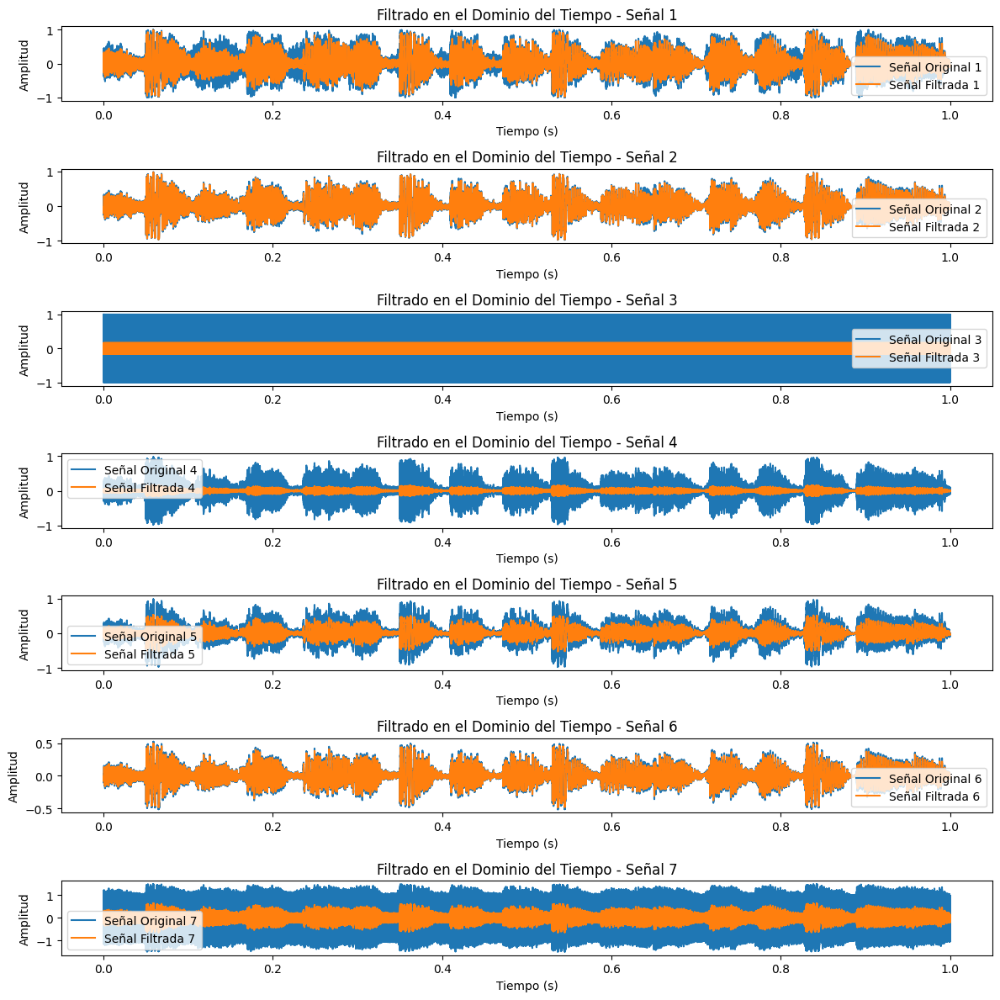

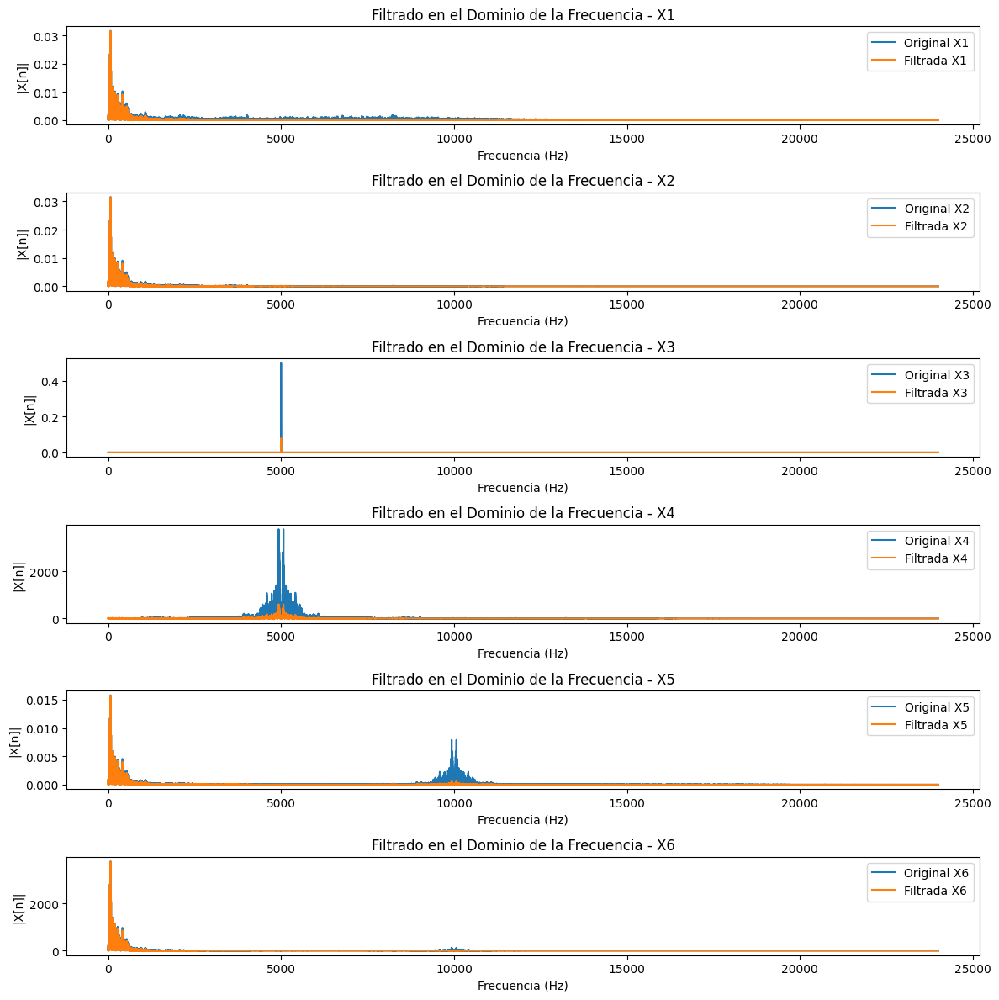

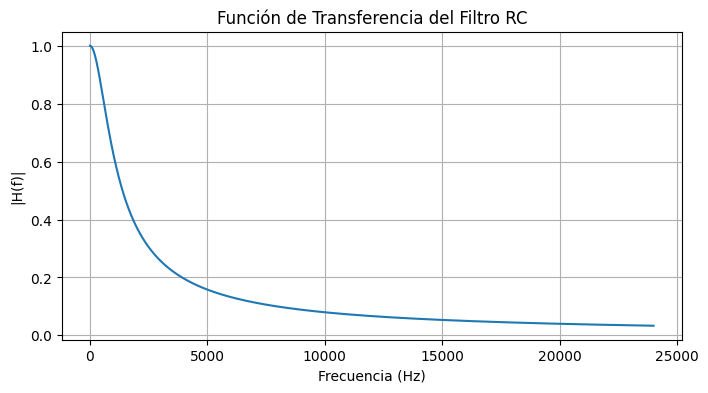

Capacitancia calculada: 1.989437e-07 F


In [36]:
# Definición de parámetros iniciales
frecuencia_corte = 800  # Frecuencia de corte (Hz)
resistencia = 1000     # Resistencia (Ohms)
# Use the signal's length to define tiempo and frecuencia
# Assuming the first signal in señales_tiempo has the representative length

señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

señal_ejemplo = señales_tiempo[0]
num_muestras = len(señal_ejemplo)
tiempo = np.linspace(0, 1, num_muestras)
frecuencia = np.fft.fftfreq(num_muestras, d=1/fs)  # Use fs from the original code


for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)  # Use fs from the original code

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, capacitancia = filtro_rc(frecuencia_corte, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RC')
plt.grid()
plt.show()

print(f"Capacitancia calculada: {capacitancia:.6e} F")


espectrogramas filtro pasa bajas

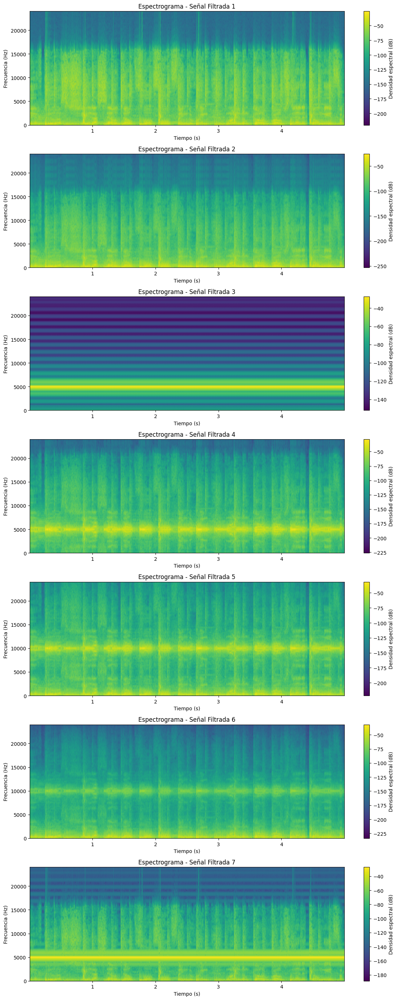

In [37]:
# Preparar títulos para las señales
títulos_señales_filtradas = [f'Espectrograma - Señal Filtrada {i + 1}' for i in range(len(señales_tiempo_filtradas))]

# Visualizar los espectrogramas de las señales filtradas
visualizar_espectrogramas(señales_tiempo, fs, títulos_señales_filtradas)


Filtro pasa bajas RL

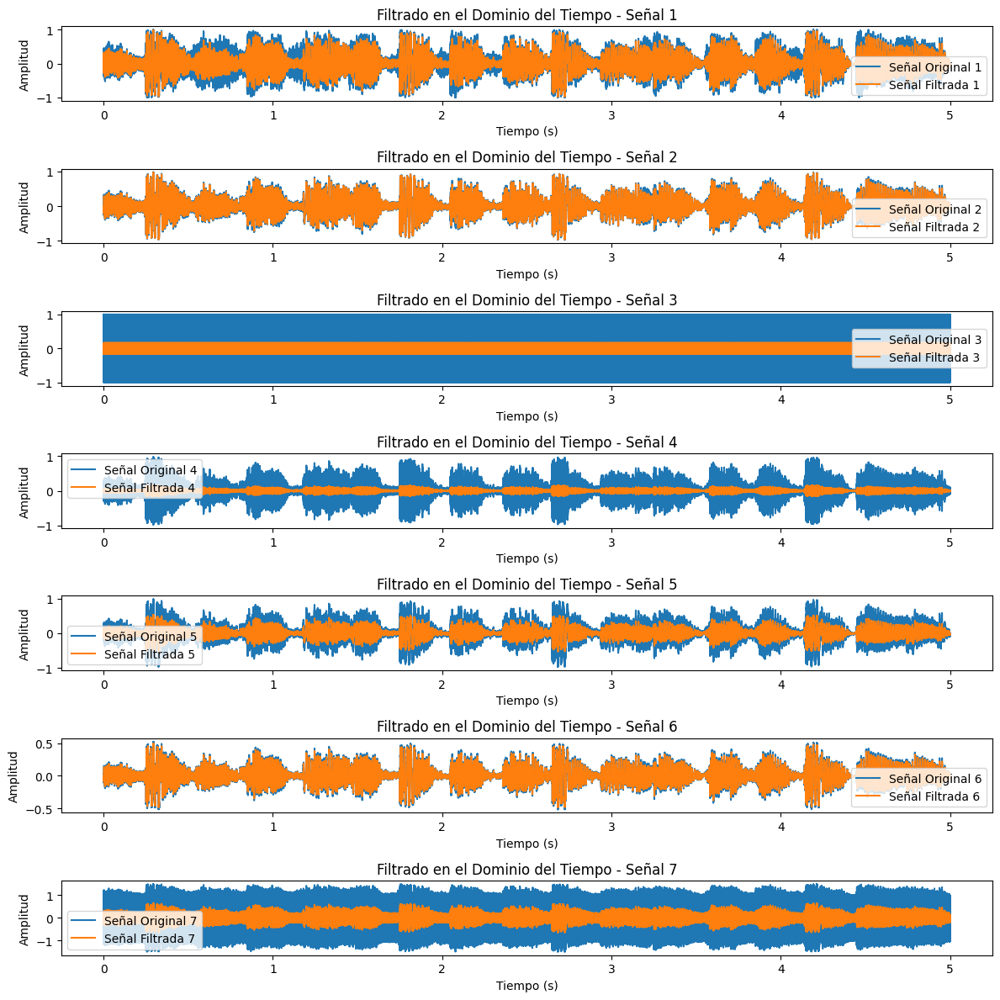

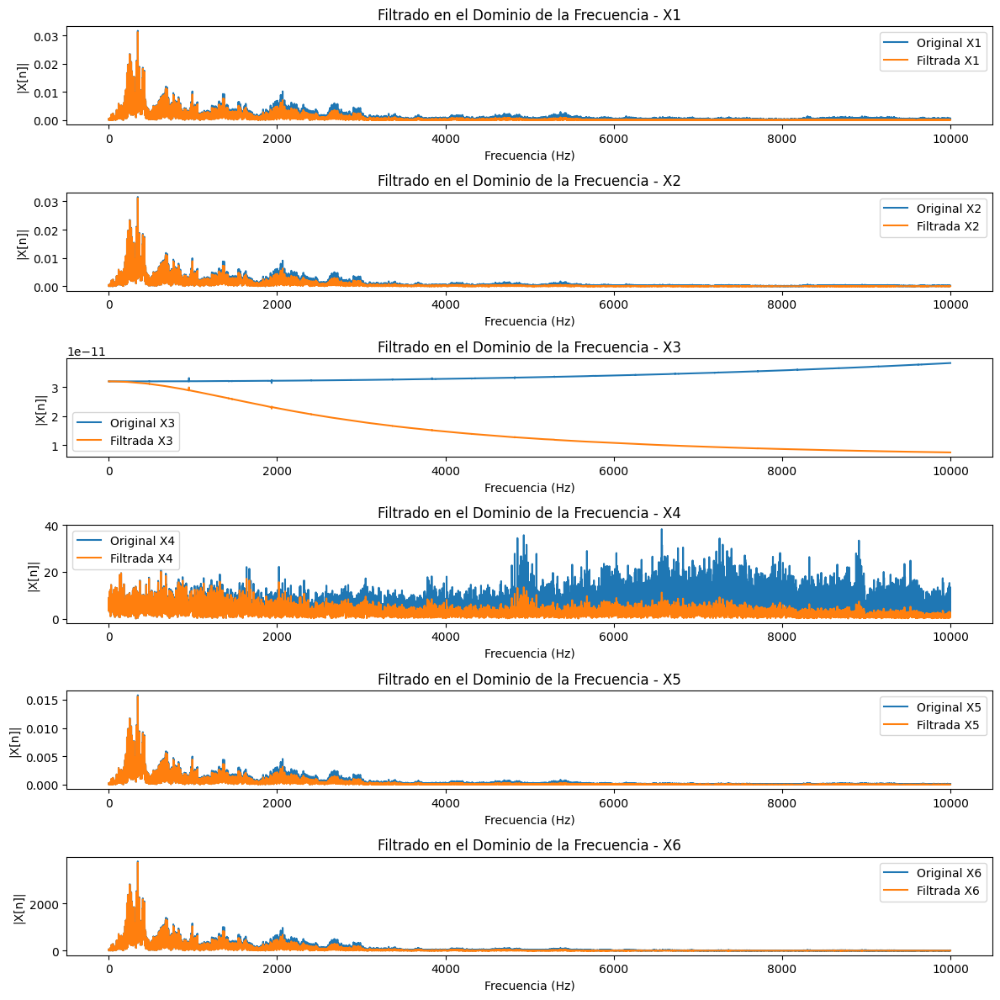

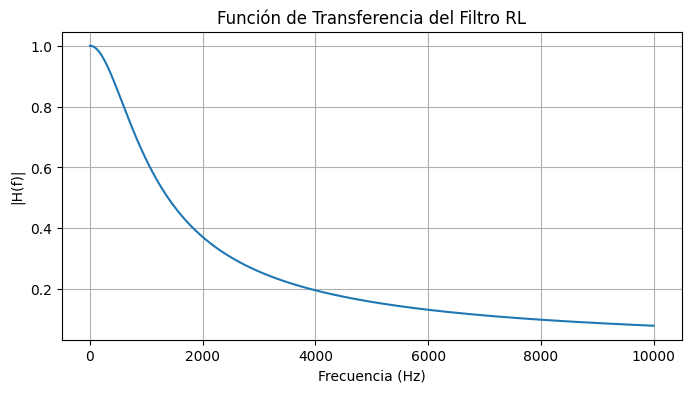

Inductancia calculada: 1.989437e-01 H


In [38]:


# Función para calcular la respuesta del filtro pasa bajas RL
def filtro_rl(frecuencia_corte, resistencia, frecuencia):
    inductancia = resistencia / (2 * np.pi * frecuencia_corte)
    H = 1 / (1 + 1j * 2 * np.pi * frecuencia * inductancia / resistencia)
    return H, inductancia

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='tiempo'):
    # Calculate the frequency response H for the entire frequency range of the signal
    num_muestras_signal = len(signal)
    frecuencia_signal = np.fft.fftfreq(num_muestras_signal, d=1/fs) # Use the actual sampling rate 'fs'
    H, inductancia = filtro_rl(frecuencia_corte, resistencia, frecuencia_signal)

    if dominio == 'tiempo':
        # Transformada de Fourier para señales en tiempo
        signal_frecuencia = np.fft.fft(signal)
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, inductancia
    elif dominio == 'frecuencia':
        # Señales ya en frecuencia
        signal_filtrada = signal * H
        return signal_filtrada, H, inductancia

# Definición de parámetros iniciales
frecuencia_corte = 800 # Frecuencia de corte (Hz)
resistencia = 1000     # Resistencia (Ohms)
frecuencia_muestreo = 20000  # Frecuencia de muestreo (Hz)
tiempo = np.linspace(0, 1, frecuencia_muestreo)
frecuencia = np.fft.fftfreq(len(tiempo), d=1/frecuencia_muestreo)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]  # Assuming 'xdf' is the correct variable
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Use the signal's length to create the time vector
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, num_muestras_signal/fs, num_muestras_signal) # Use 'fs' to create time vector

    # Calculate the frequency vector based on the current signal's length and sampling rate 'fs'
    frecuencia_señal = np.fft.fftfreq(num_muestras_signal, d=1/fs)

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo_señal, frecuencia_señal, dominio='tiempo')
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use a time vector that matches the length of the signal being plotted:
    num_muestras_signal = len(original)  # Get the length of the current signal
    tiempo_plot = np.linspace(0, num_muestras_signal / fs, num_muestras_signal)  # Create time vector for plotting

    plt.plot(tiempo_plot, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_plot, filtrada, label=f'Señal Filtrada {i + 1}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()



señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, inductancia = filtro_rl(frecuencia_corte, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RL')
plt.grid()
plt.show()

print(f"Inductancia calculada: {inductancia:.6e} H")

pasa altas RC

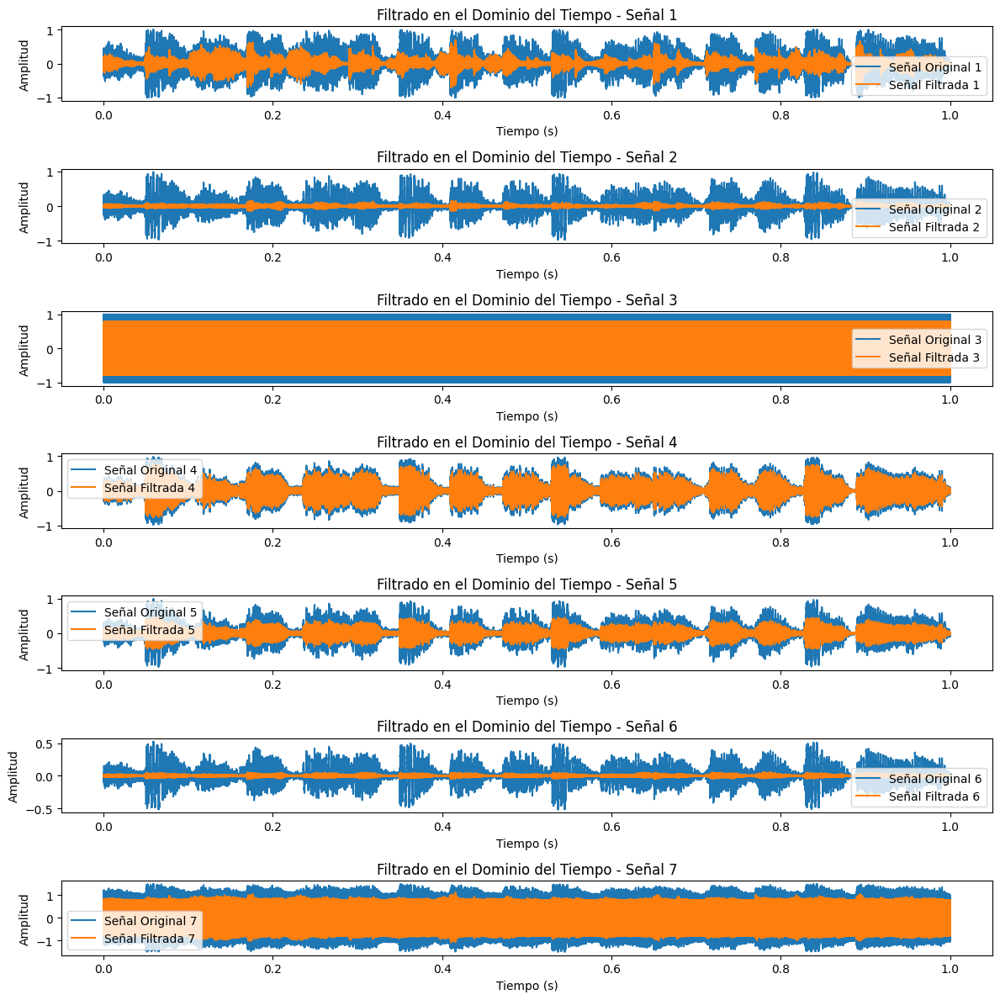

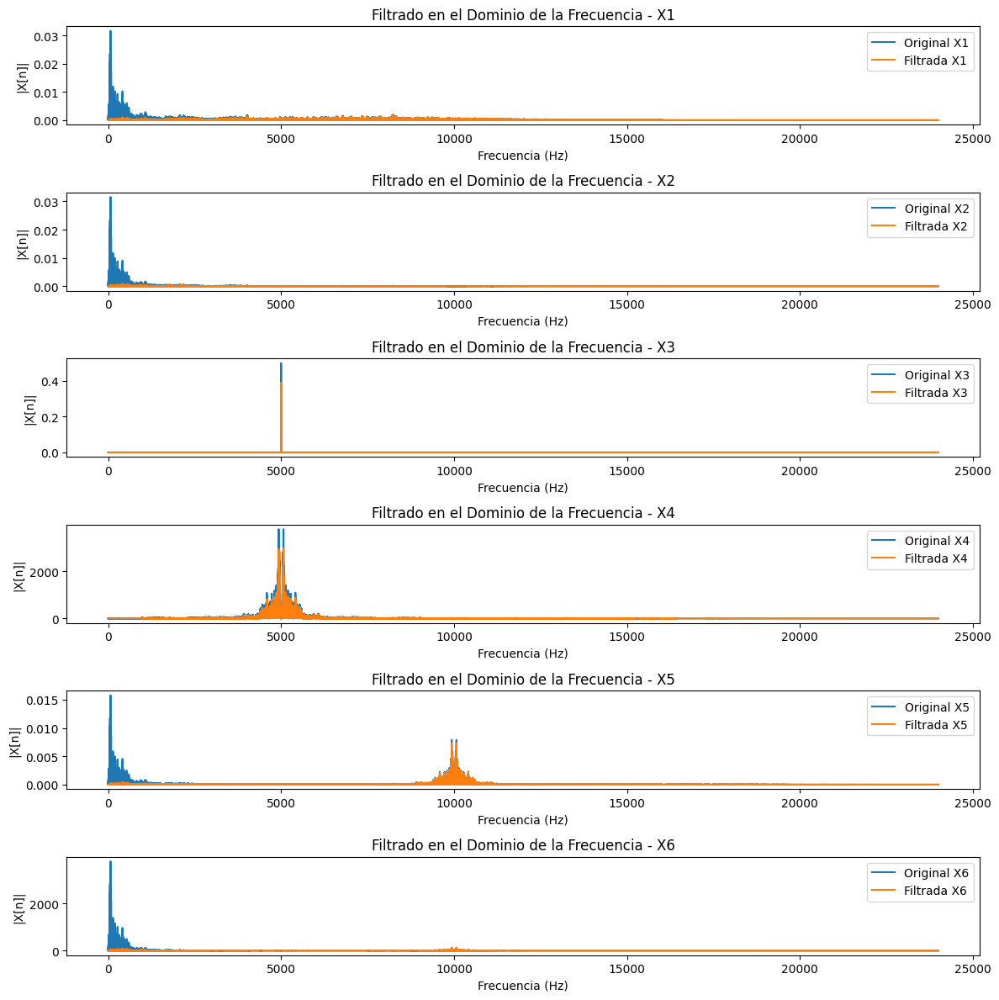

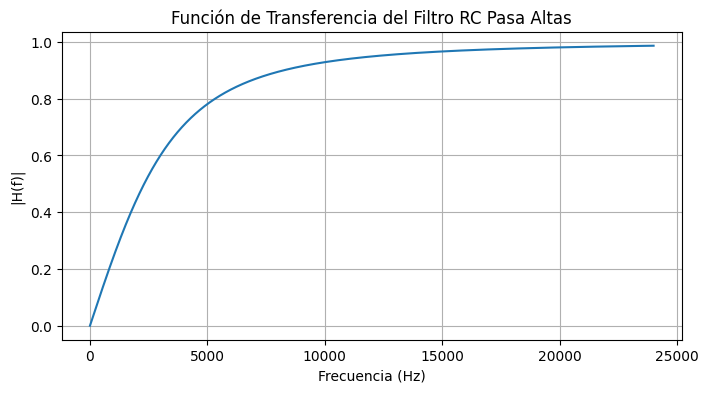

Capacitancia calculada: 3.978874e-08 F


In [39]:

# Función para calcular la respuesta del filtro pasa altas RC
def filtro_rc_pasa_altas(frecuencia_corte, resistencia, frecuencia):
    capacitancia = 1 / (2 * np.pi * resistencia * frecuencia_corte)
    H = (1j * 2 * np.pi * frecuencia * resistencia * capacitancia) / (1 + 1j * 2 * np.pi * frecuencia * resistencia * capacitancia)
    return H, capacitancia

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='tiempo'):
    # Calculate H based on the signal's frequency range
    # Use the length of the current signal to determine the appropriate frequency range
    num_muestras_signal = len(signal)
    H, capacitancia = filtro_rc_pasa_altas(frecuencia_corte, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        # Transformada de Fourier para señales en tiempo
        signal_frecuencia = np.fft.fft(signal)
        # Apply the filter to the signal's frequency representation
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, capacitancia
    elif dominio == 'frecuencia':
        # Señales ya en frecuencia
        # Apply the filter to the signal's frequency representation
        signal_filtrada = signal * H
        return signal_filtrada, H, capacitancia

# Definición de parámetros iniciales
frecuencia_corte = 4000  # Frecuencia de corte (Hz)
resistencia = 1000     # Resistencia (Ohms)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)  # Use fs from the original code

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()


señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, capacitancia = filtro_rc_pasa_altas(frecuencia_corte, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RC Pasa Altas')
plt.grid()
plt.show()

print(f"Capacitancia calculada: {capacitancia:.6e} F")


pasa altas RL

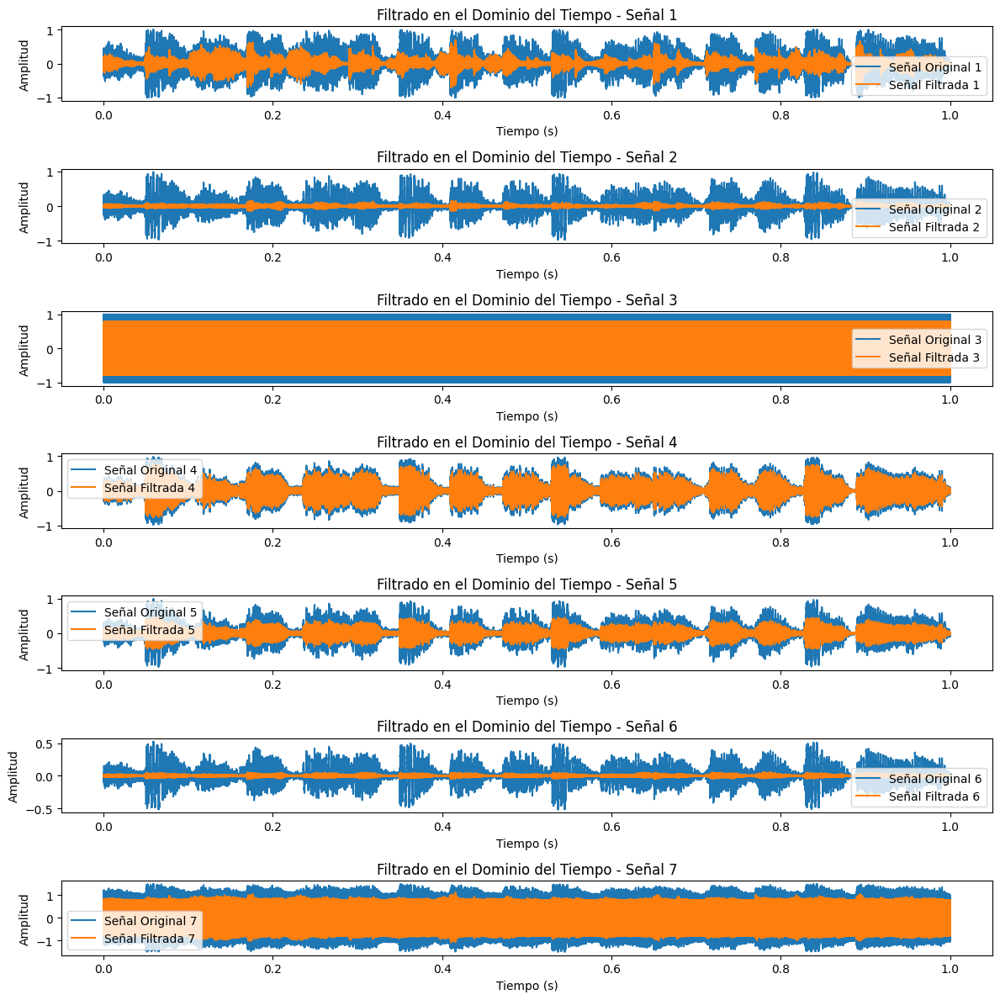

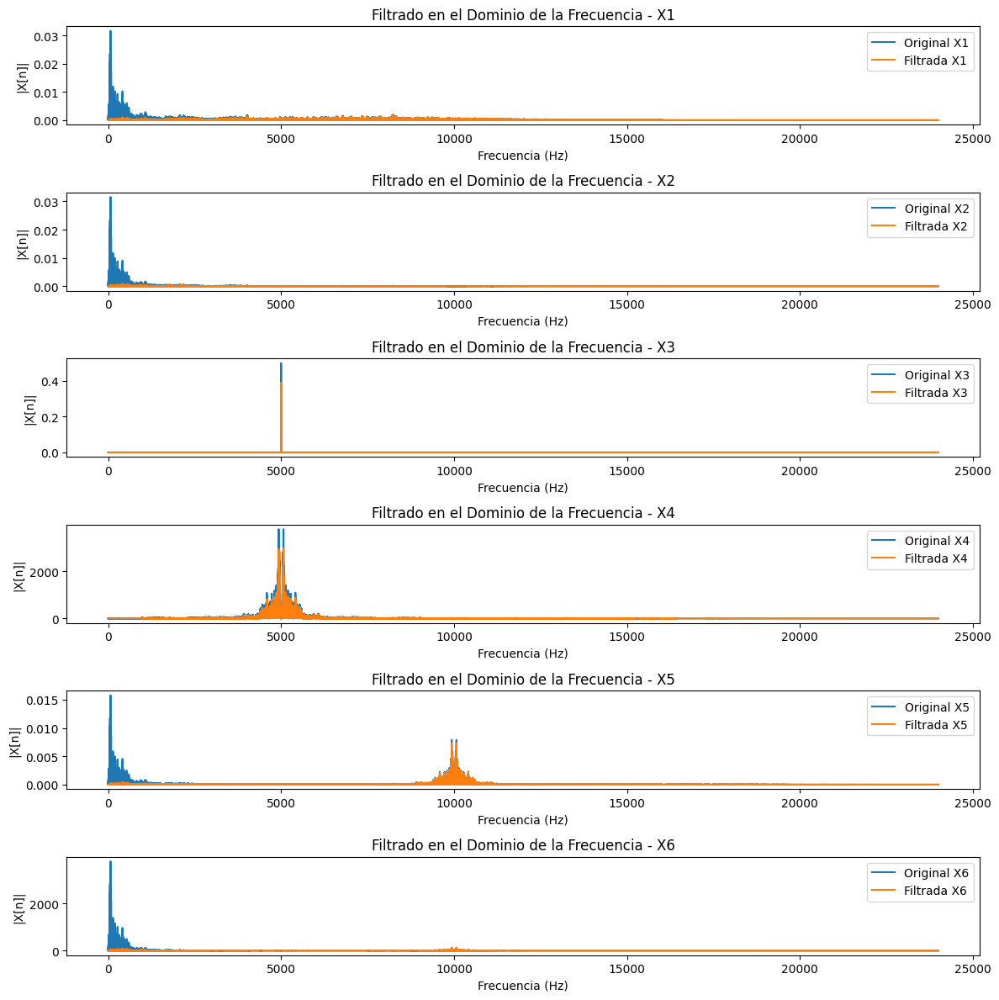

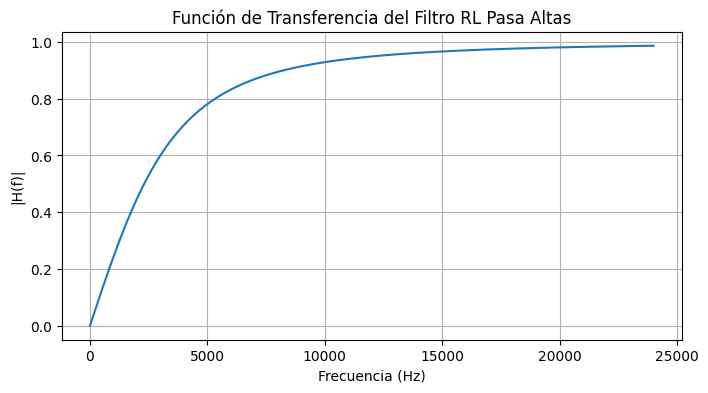

Inductancia calculada: 3.978874e-02 H


In [40]:


# Función para calcular la respuesta del filtro pasa altas RL
def filtro_rl_pasa_altas(frecuencia_corte, resistencia, frecuencia):
    inductancia = resistencia / (2 * np.pi * frecuencia_corte)
    H = (1j * 2 * np.pi * frecuencia * inductancia) / (resistencia + 1j * 2 * np.pi * frecuencia * inductancia)
    return H, inductancia

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='tiempo'):
    # Calculate H based on the signal's frequency range
    # Use the length of the current signal to determine the appropriate frequency range
    num_muestras_signal = len(signal)
    H, inductancia = filtro_rl_pasa_altas(frecuencia_corte, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        # Transformada de Fourier para señales en tiempo
        signal_frecuencia = np.fft.fft(signal)
        # Apply the filter to the signal's frequency representation
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, inductancia
    elif dominio == 'frecuencia':
        # Señales ya en frecuencia
        # Apply the filter to the signal's frequency representation
        signal_filtrada = signal * H
        return signal_filtrada, H, inductancia

# Definición de parámetros iniciales
frecuencia_corte = 4000  # Frecuencia de corte (Hz)
resistencia = 1000     # Resistencia (Ohms)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)  # Use fs from the original code

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()


señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, inductancia = filtro_rl_pasa_altas(frecuencia_corte, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RL Pasa Altas')
plt.grid()
plt.show()

print(f"Inductancia calculada: {inductancia:.6e} H")


Espectrograma filtro pasa altas

In [54]:
# Función para visualizar el espectrograma de una lista de señales
def visualizar_espectrogramas(señales, frecuencia_muestreo, títulos):
    plt.figure(figsize=(12, len(señales) * 4))

    for i, señal in enumerate(señales):
        # Cálculo del espectrograma
        # Use specgram instead of spectrograma
        f, t, Sxx = plt.specgram(señal, Fs=frecuencia_muestreo, NFFT=256, noverlap=128, mode='psd', scale='dB', cmap='viridis')
        # Visualización del espectrograma
        plt.subplot(len(señales), 1, i + 1)
        plt.colorbar(label='Densidad espectral (dB)')
        plt.title(títulos[i])
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Frecuencia (Hz)')
        plt.ylim(0, frecuencia_muestreo / 2)
        plt.specgram(señal, Fs=frecuencia_muestreo, NFFT=256, noverlap=128, mode='psd', scale='dB', cmap='viridis')

    plt.tight_layout()
    plt.show()

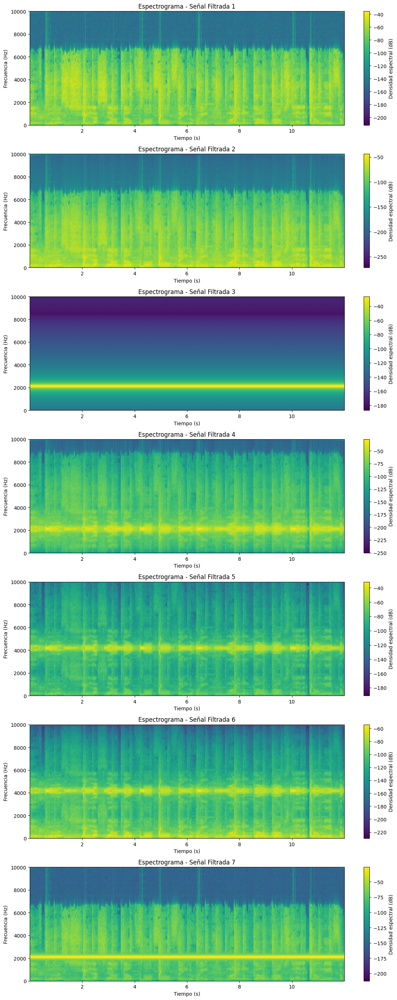

In [55]:
import numpy as np
import matplotlib.pyplot as plt

# Función para visualizar el espectrograma de una lista de señales
def visualizar_espectrogramas(señales, frecuencia_muestreo, títulos):
    plt.figure(figsize=(12, len(señales) * 4))

    for i, señal in enumerate(señales):
        plt.subplot(len(señales), 1, i + 1)  # Crear subgráficos correctamente

        # Cálculo y visualización del espectrograma
        Pxx, freqs, bins, im = plt.specgram(señal, Fs=frecuencia_muestreo, NFFT=256, noverlap=128, mode='psd', scale='dB', cmap='viridis')

        plt.colorbar(im, label='Densidad espectral (dB)')  # Agregar barra de colores a cada gráfico
        plt.title(títulos[i])
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Frecuencia (Hz)')
        plt.ylim(0, frecuencia_muestreo / 2)

    plt.tight_layout()
    plt.show()

# Llamada de prueba (asegúrate de que las señales y títulos están definidos)
# señales_tiempo_filtradas y frecuencia_muestreo deben estar definidos antes
if 'señales_tiempo_filtradas' in globals():
    títulos_señales_filtradas = [f'Espectrograma - Señal Filtrada {i + 1}' for i in range(len(señales_tiempo_filtradas))]
    visualizar_espectrogramas(señales_tiempo_filtradas, frecuencia_muestreo, títulos_señales_filtradas)
else:
    print("Error: 'señales_tiempo_filtradas' no está definida.")


filtro pasa bandas RLC

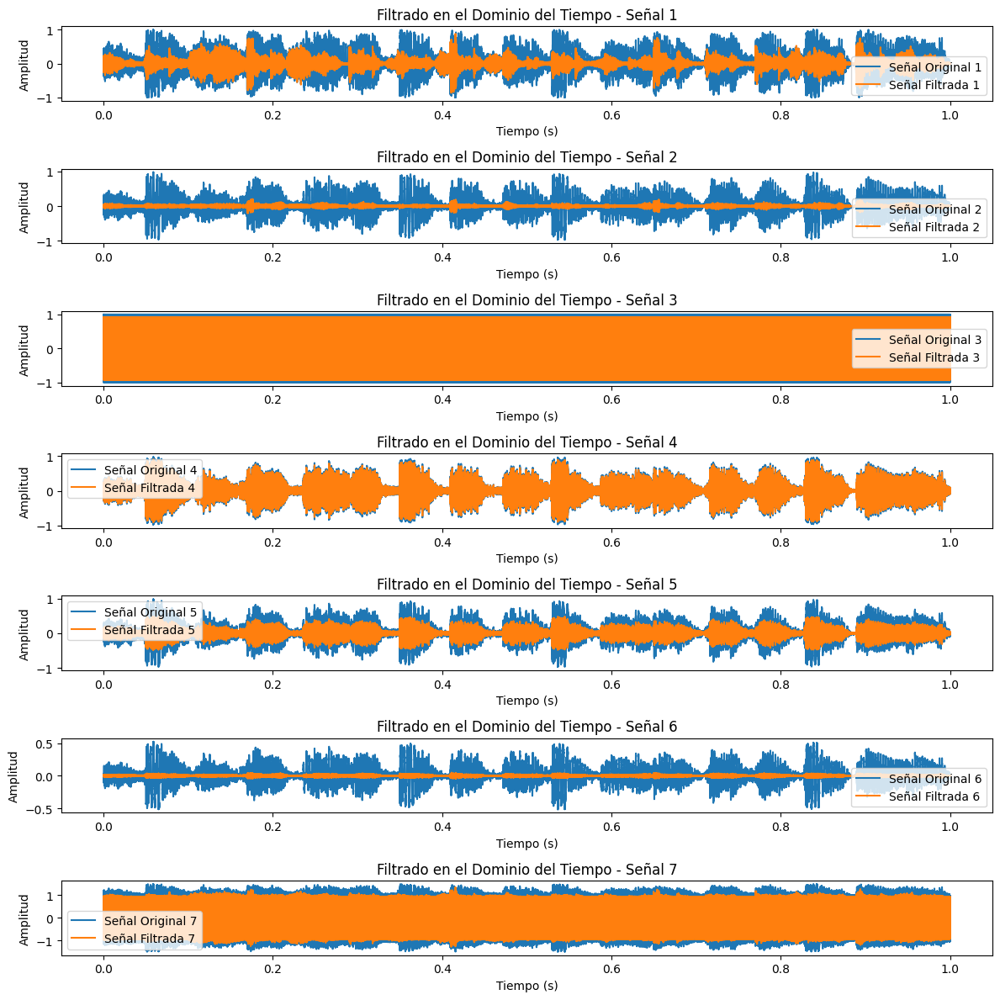

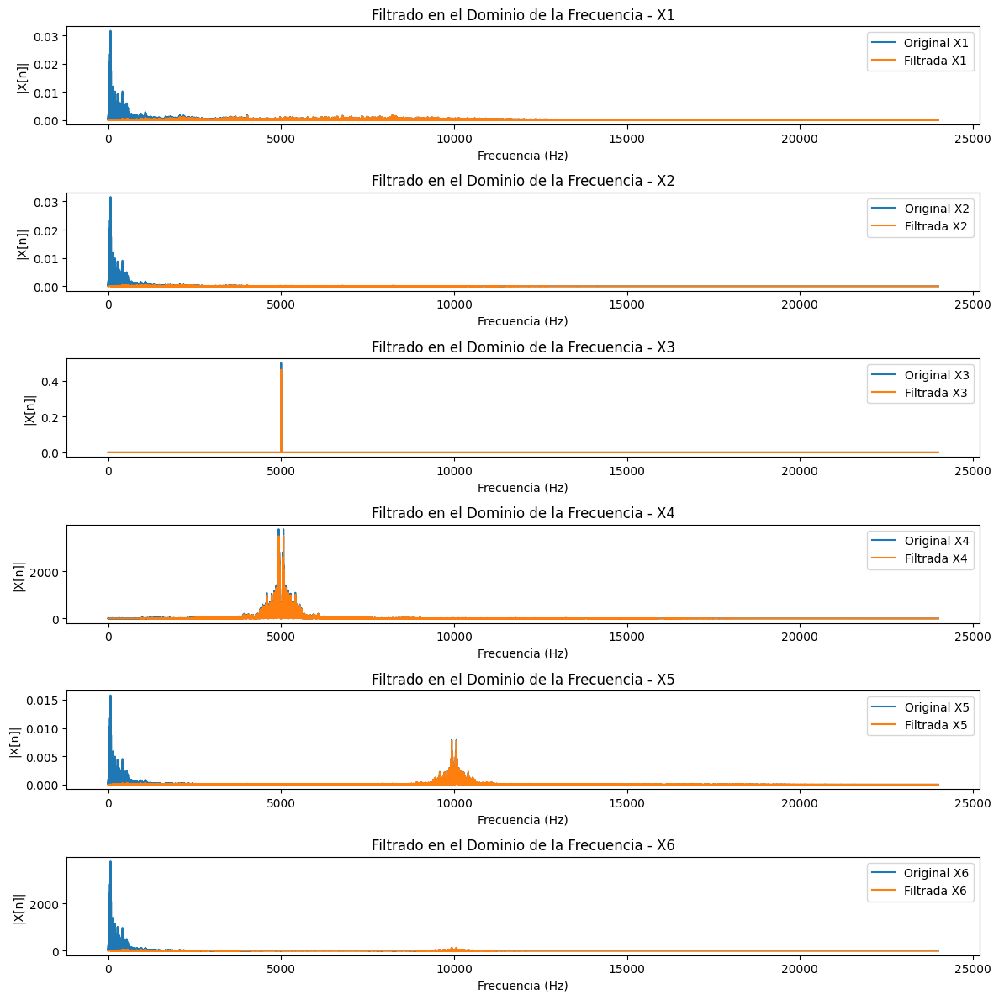

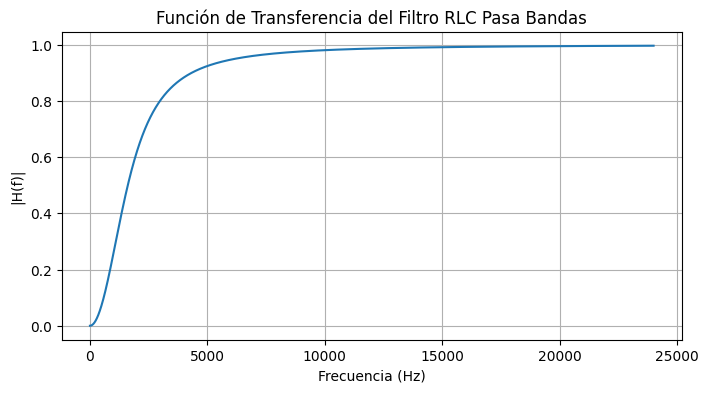

Frecuencia central calculada: 1788.85 Hz
Ancho de banda calculado: 3200.00 Hz
Inductancia calculada: 4.973592e-02 H
Capacitancia calculada: 1.591549e-07 F


In [56]:


def filtro_rlc_pasa_bandas(frecuencia_inicial, frecuencia_final, resistencia, frecuencia):
    frecuencia_central = np.sqrt(frecuencia_inicial * frecuencia_final)
    ancho_banda = frecuencia_final - frecuencia_inicial
    inductancia = resistencia / (2 * np.pi * ancho_banda)
    capacitancia = 1 / (4 * np.pi**2 * inductancia * frecuencia_central**2)

    # Calculate the transfer function for each frequency in the input array
    H = np.zeros(len(frecuencia), dtype=complex)  # Initialize H as an array
    for i, f in enumerate(frecuencia):
        omega = 2 * np.pi * f
        epsilon = 1e-12  # A small value to avoid division by zero
        H[i] = (1j * omega * inductancia) / (resistencia + 1j * omega * inductancia + (1 / (1j * omega * capacitancia + epsilon))) #Corrected indentation
    # Return H as an array of complex values
    return H, frecuencia_central, ancho_banda, inductancia, capacitancia #Corrected indentation
#rest of the code remains the same
# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='tiempo'):
    # Calculate H based on the signal's frequency range
    # Use the length of the current signal to determine the appropriate frequency range
    num_muestras_signal = len(signal)
    H, frecuencia_central, ancho_banda, inductancia, capacitancia = filtro_rlc_pasa_bandas(
        frecuencia_inicial, frecuencia_final, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        # Transformada de Fourier para señales en tiempo
        signal_frecuencia = np.fft.fft(signal)
        # Apply the filter to the signal's frequency representation
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, frecuencia_central, ancho_banda, inductancia, capacitancia
    elif dominio == 'frecuencia':
        # Señales ya en frecuencia
        # Apply the filter to the signal's frequency representation
        signal_filtrada = signal * H
        return signal_filtrada, H, frecuencia_central, ancho_banda, inductancia, capacitancia

# Definición de parámetros iniciales
frecuencia_inicial = 800   # Frecuencia inicial de corte (Hz)
frecuencia_final = 4000  # Frecuencia final de corte (Hz)
resistencia = 1000         # Resistencia (Ohms)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)  # Use fs from the original code

    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()


señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, frecuencia_central, ancho_banda, inductancia, capacitancia = filtro_rlc_pasa_bandas(
    frecuencia_inicial, frecuencia_final, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RLC Pasa Bandas')
plt.grid()
plt.show()

print(f"Frecuencia central calculada: {frecuencia_central:.2f} Hz")
print(f"Ancho de banda calculado: {ancho_banda:.2f} Hz")
print(f"Inductancia calculada: {inductancia:.6e} H")
print(f"Capacitancia calculada: {capacitancia:.6e} F")

espectrogramas de filtro pasa bandas

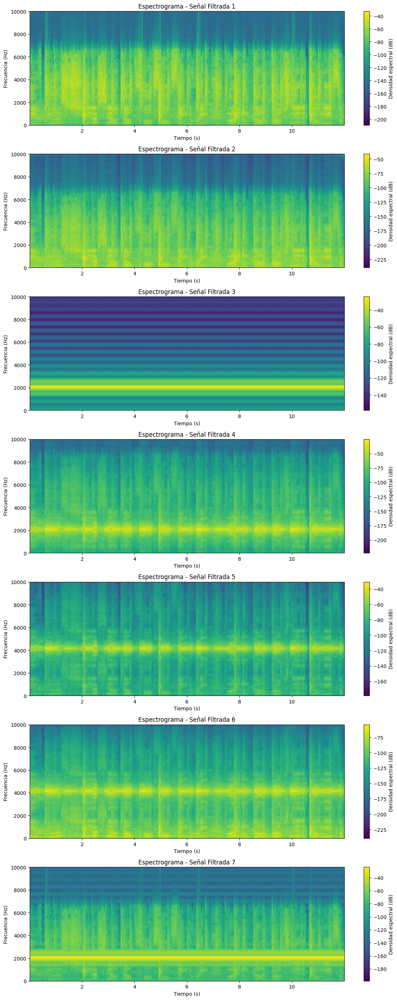

In [57]:
# Función para visualizar el espectrograma de una lista de señales
def visualizar_espectrogramas(señales, frecuencia_muestreo, títulos):
    plt.figure(figsize=(12, len(señales) * 4))

    for i, señal in enumerate(señales):
        # Cálculo del espectrograma
        f, t, Sxx = spectrogram(señal, fs=frecuencia_muestreo, nperseg=256, noverlap=128, scaling='density')

        # Visualización del espectrograma
        plt.subplot(len(señales), 1, i + 1)
        plt.pcolormesh(t, f, 10 * np.log10(Sxx), shading='gouraud')
        plt.colorbar(label='Densidad espectral (dB)')
        plt.title(títulos[i])
        plt.xlabel('Tiempo (s)')
        plt.ylabel('Frecuencia (Hz)')
        plt.ylim(0, frecuencia_muestreo / 2)

    plt.tight_layout()
    plt.show()

# Preparar títulos para las señales
títulos_señales_filtradas = [f'Espectrograma - Señal Filtrada {i + 1}' for i in range(len(señales_tiempo_filtradas))]

# Visualizar los espectrogramas de las señales filtradas
visualizar_espectrogramas(señales_tiempo_filtradas, frecuencia_muestreo, títulos_señales_filtradas)

filtro pasa bandas RC

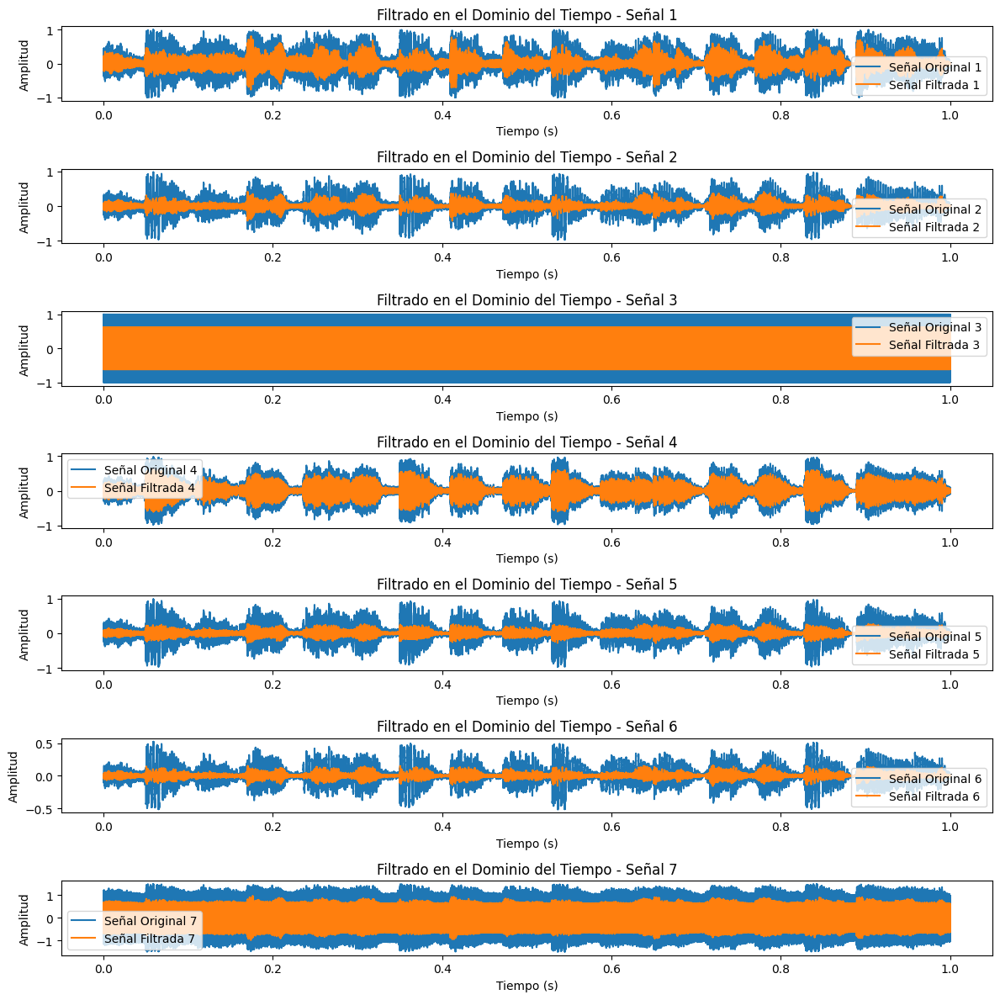

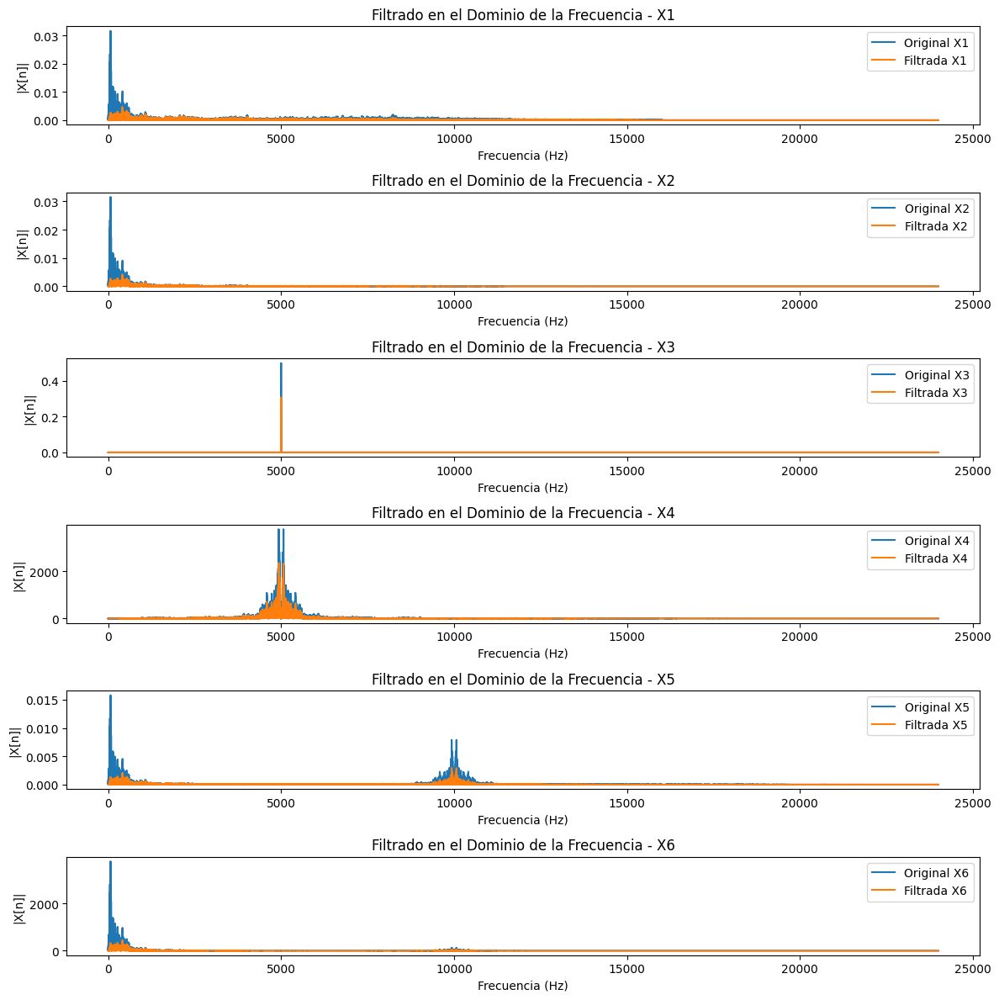

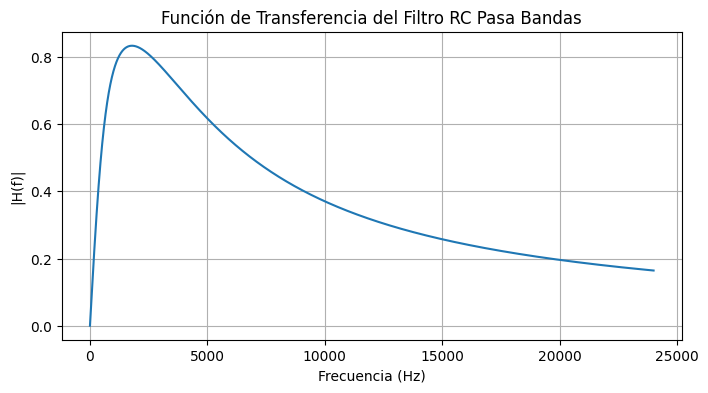

Frecuencia de corte alta calculada: 800.00 Hz
Frecuencia de corte baja calculada: 4000.00 Hz
Capacitancia del filtro pasa altas: 1.989437e-07 F
Capacitancia del filtro pasa bajas: 3.978874e-08 F


In [58]:


def filtro_rc_pasa_bandas(frecuencia_inicial, frecuencia_final, resistencia, frecuencia):
    # Cálculo de componentes para los filtros RC
    fc_baja = frecuencia_final  # Frecuencia de corte del filtro pasa bajas
    fc_alta = frecuencia_inicial  # Frecuencia de corte del filtro pasa altas

    # Cálculo de capacitancias para los filtros RC
    capacitancia_baja = 1 / (2 * np.pi * resistencia * fc_baja)
    capacitancia_alta = 1 / (2 * np.pi * resistencia * fc_alta)

    # Inicialización de la función de transferencia
    H = np.zeros(len(frecuencia), dtype=complex)

    for i, f in enumerate(frecuencia):
        omega = 2 * np.pi * f
        # Avoid division by zero when omega is 0
        if omega == 0:
            H[i] = 0  # or any other appropriate value for DC component
            continue

        # Transferencia del filtro pasa altas RC
        H_alta = 1 / (1 + 1 / (1j * omega * resistencia * capacitancia_alta))
        # Transferencia del filtro pasa bajas RC
        H_baja = 1 / (1 + 1j * omega * resistencia * capacitancia_baja)
        # Combinación en cascada para formar el filtro pasa bandas
        H[i] = H_alta * H_baja

    return H, fc_alta, fc_baja, capacitancia_alta, capacitancia_baja

def aplicar_filtro(signal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='tiempo'):
    num_muestras_signal = len(signal)
    H, fc_alta, fc_baja, capacitancia_alta, capacitancia_baja = filtro_rc_pasa_bandas(
        frecuencia_inicial, frecuencia_final, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        signal_frecuencia = np.fft.fft(signal)
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, fc_alta, fc_baja, capacitancia_alta, capacitancia_baja

    elif dominio == 'frecuencia':
        signal_filtrada = signal * H
        return signal_filtrada, H, fc_alta, fc_baja, capacitancia_alta, capacitancia_baja

# Definición de parámetros iniciales
frecuencia_inicial = 800  # Frecuencia inicial de corte (Hz)
frecuencia_final = 4000    # Frecuencia final de corte (Hz)
resistencia = 1000         # Resistencia (Ohms)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)

    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo_señal, frecuencia, dominio='tiempo')
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)
    tiempo_señal = np.linspace(0, 1, len(original))
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

# Aplicar el filtro a señales en el dominio de la frecuencia
señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

for señal in señales_frecuencia:
    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, fc_alta, fc_baja, capacitancia_alta, capacitancia_baja = filtro_rc_pasa_bandas(
    frecuencia_inicial, frecuencia_final, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RC Pasa Bandas')
plt.grid()
plt.show()

print(f"Frecuencia de corte alta calculada: {fc_alta:.2f} Hz")
print(f"Frecuencia de corte baja calculada: {fc_baja:.2f} Hz")
print(f"Capacitancia del filtro pasa altas: {capacitancia_alta:.6e} F")
print(f"Capacitancia del filtro pasa bajas: {capacitancia_baja:.6e} F")


filtros pasa bandas RL

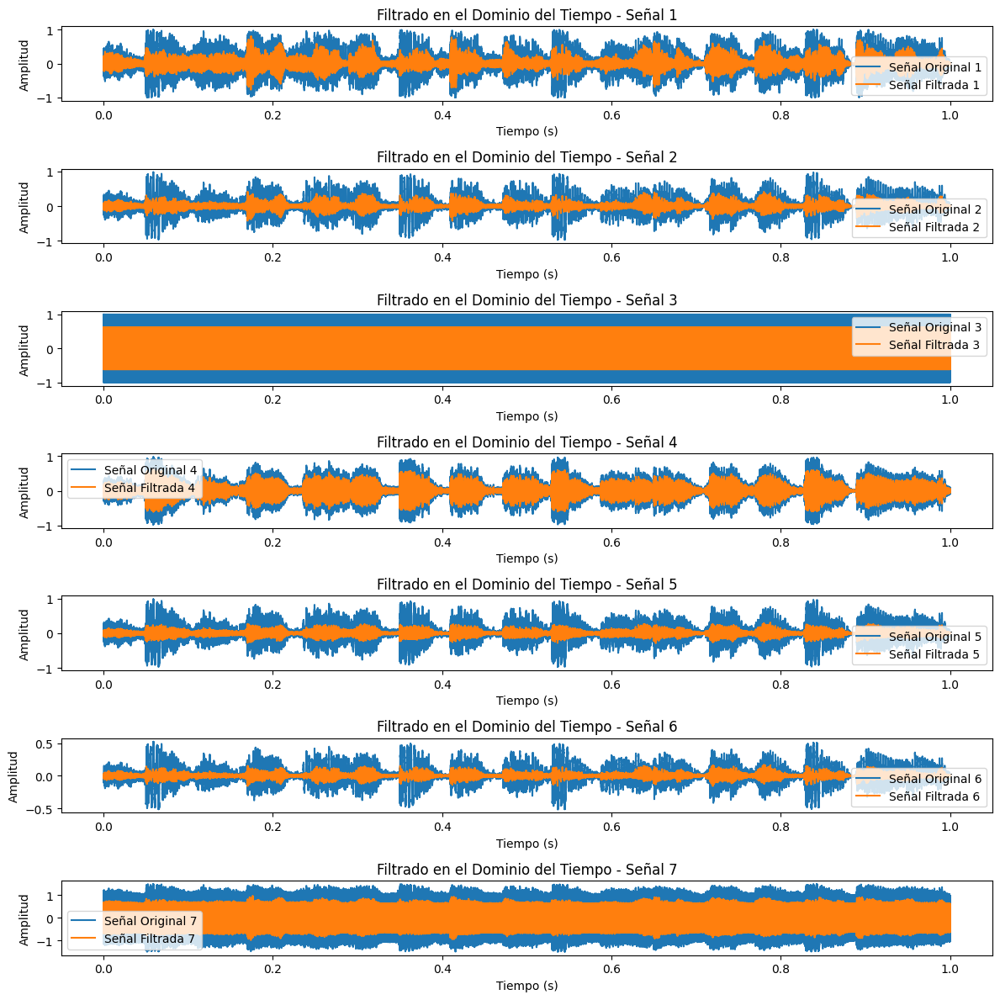

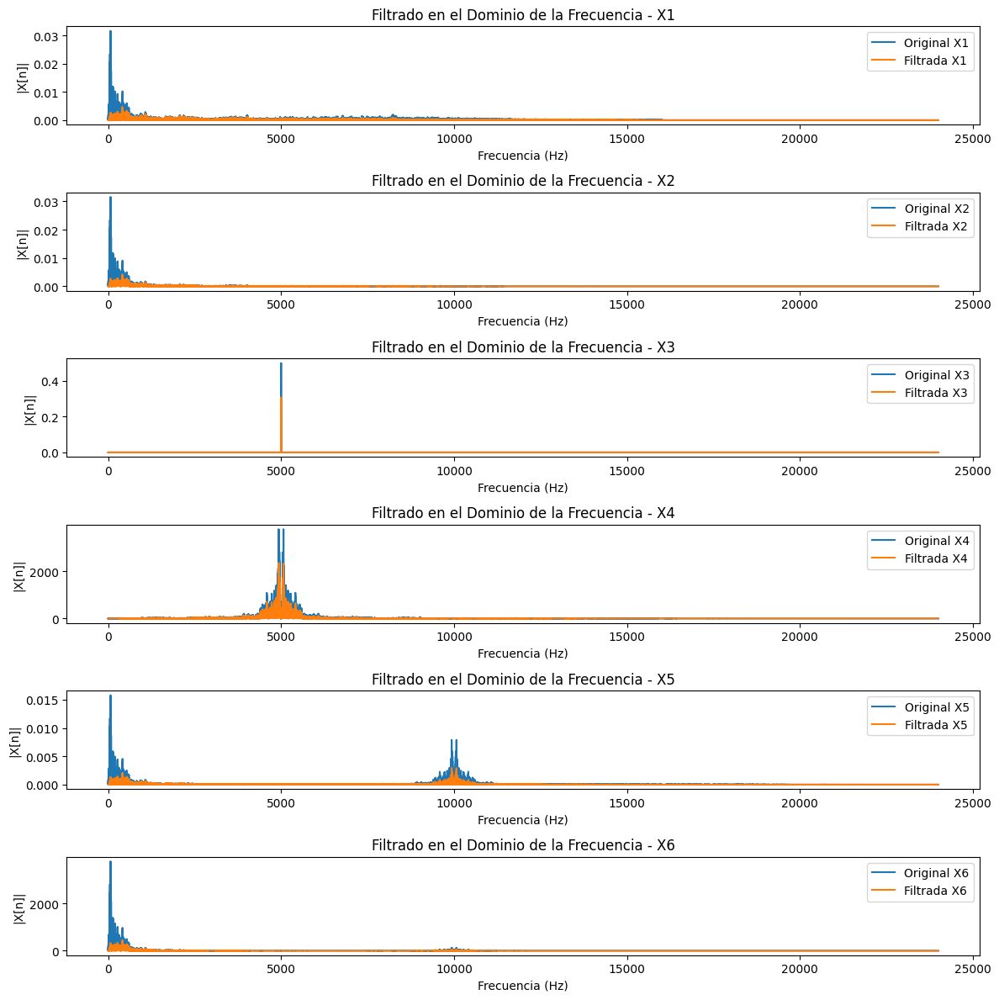

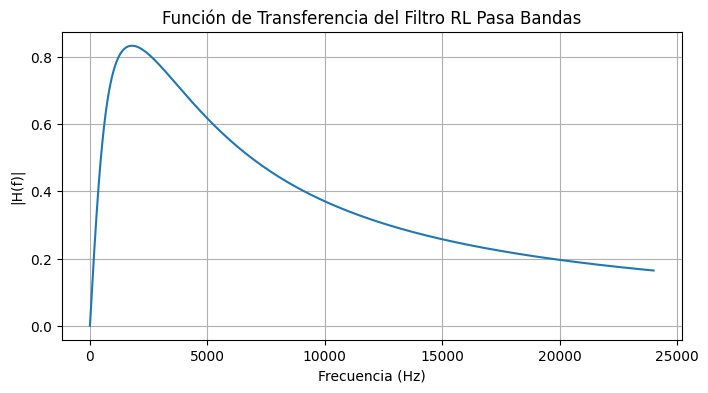

Frecuencia de corte alta calculada: 800.00 Hz
Frecuencia de corte baja calculada: 4000.00 Hz
Inductancia del filtro pasa altas: 1.989437e-01 H
Inductancia del filtro pasa bajas: 3.978874e-02 H


In [59]:

def filtro_rl_pasa_bandas(frecuencia_inicial, frecuencia_final, resistencia, frecuencia):
    # Cálculo de componentes para los filtros RL
    fc_baja = frecuencia_final  # Frecuencia de corte del filtro pasa bajas
    fc_alta = frecuencia_inicial  # Frecuencia de corte del filtro pasa altas

    # Cálculo de inductancias para los filtros RL
    inductancia_baja = resistencia / (2 * np.pi * fc_baja)
    inductancia_alta = resistencia / (2 * np.pi * fc_alta)

    # Inicialización de la función de transferencia
    H = np.zeros(len(frecuencia), dtype=complex)

    for i, f in enumerate(frecuencia):
        omega = 2 * np.pi * f
        # Evitar división por cero cuando omega es 0
        if omega == 0:
            H[i] = 0
            continue

        # Transferencia del filtro pasa altas RL
        H_alta = 1j * omega * inductancia_alta / (resistencia + 1j * omega * inductancia_alta)
        # Transferencia del filtro pasa bajas RL
        H_baja = resistencia / (resistencia + 1j * omega * inductancia_baja)
        # Combinación en cascada para formar el filtro pasa bandas
        H[i] = H_alta * H_baja

    return H, fc_alta, fc_baja, inductancia_alta, inductancia_baja

def aplicar_filtro(signal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='tiempo'):
    num_muestras_signal = len(signal)
    H, fc_alta, fc_baja, inductancia_alta, inductancia_baja = filtro_rl_pasa_bandas(
        frecuencia_inicial, frecuencia_final, resistencia, frecuencia[:num_muestras_signal])

    if dominio == 'tiempo':
        signal_frecuencia = np.fft.fft(signal)
        signal_frecuencia_filtrada = signal_frecuencia * H
        signal_filtrada = np.fft.ifft(signal_frecuencia_filtrada)
        return signal_filtrada.real, H, fc_alta, fc_baja, inductancia_alta, inductancia_baja

    elif dominio == 'frecuencia':
        signal_filtrada = signal * H
        return signal_filtrada, H, fc_alta, fc_baja, inductancia_alta, inductancia_baja

# Definición de parámetros iniciales
frecuencia_inicial = 800  # Frecuencia inicial de corte (Hz)
frecuencia_final = 4000    # Frecuencia final de corte (Hz)
resistencia = 1000         # Resistencia (Ohms)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/fs)

    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo_señal, frecuencia, dominio='tiempo')
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)
    tiempo_señal = np.linspace(0, 1, len(original))
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

# Aplicar el filtro a señales en el dominio de la frecuencia
señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

for señal in señales_frecuencia:
    señal_filtrada, _, _, _, _, _ = aplicar_filtro(
        señal, frecuencia_inicial, frecuencia_final, resistencia, tiempo, frecuencia, dominio='frecuencia')
    señales_frecuencia_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio de la frecuencia
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_frecuencia, señales_frecuencia_filtradas)):
    plt.subplot(len(señales_frecuencia), 1, i + 1)
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(original[:len(frecuencia)//2]), label=f'Original X{i + 1}')
    plt.plot(frecuencia[:len(frecuencia)//2], np.abs(filtrada[:len(frecuencia)//2]), label=f'Filtrada X{i + 1}')
    plt.xlabel('Frecuencia (Hz)')
    plt.ylabel('|X[n]|')
    plt.legend()
    plt.title(f'Filtrado en el Dominio de la Frecuencia - X{i + 1}')
plt.tight_layout()
plt.show()

# Visualización de la función de transferencia del filtro
H_frecuencia, fc_alta, fc_baja, inductancia_alta, inductancia_baja = filtro_rl_pasa_bandas(
    frecuencia_inicial, frecuencia_final, resistencia, frecuencia)
plt.figure(figsize=(8, 4))
plt.plot(frecuencia[:len(frecuencia)//2], np.abs(H_frecuencia[:len(frecuencia)//2]))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('|H(f)|')
plt.title('Función de Transferencia del Filtro RL Pasa Bandas')
plt.grid()
plt.show()

print(f"Frecuencia de corte alta calculada: {fc_alta:.2f} Hz")
print(f"Frecuencia de corte baja calculada: {fc_baja:.2f} Hz")
print(f"Inductancia del filtro pasa altas: {inductancia_alta:.6e} H")
print(f"Inductancia del filtro pasa bajas: {inductancia_baja:.6e} H")

FILTROS DIGITALES

filtro pasa bajas

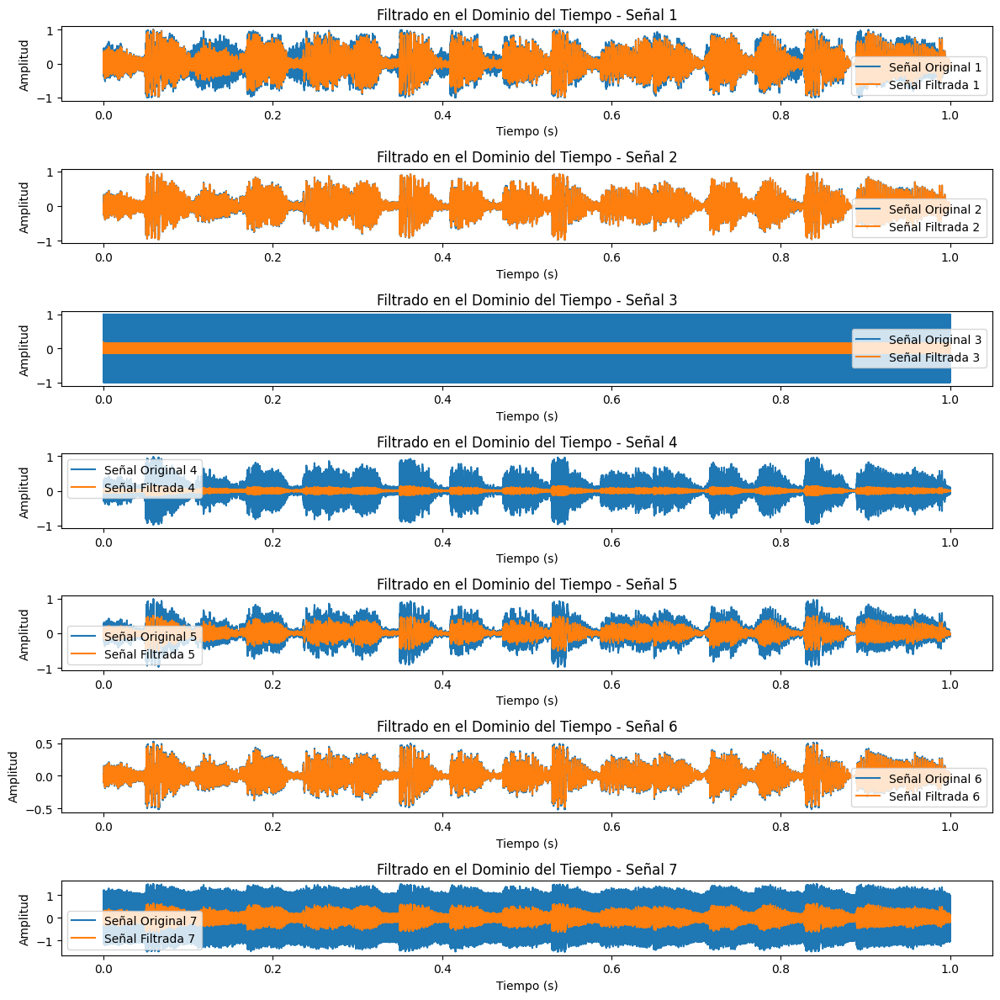

El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.


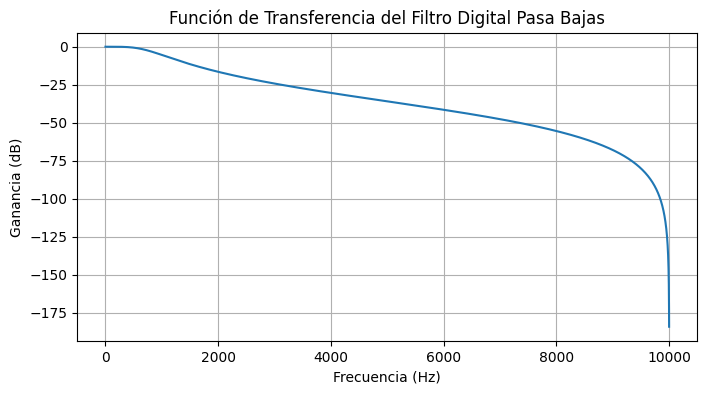

In [61]:
from scipy.signal import butter, lfilter, freqz

# Función para calcular la respuesta del filtro pasa bajas digital
def filtro_digital_pasa_bajas(frecuencia_corte, frecuencia_muestreo, orden=2):
    nyquist = 0.5 * frecuencia_muestreo
    frecuencia_normalizada = frecuencia_corte / nyquist
    b, a = butter(orden, frecuencia_normalizada, btype='low', analog=False)
    return b, a

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, frecuencia_muestreo, tiempo, frecuencia, dominio='tiempo'):
    if dominio == 'tiempo':
        # Crear el filtro digital pasa bajas
        b, a = filtro_digital_pasa_bajas(frecuencia_corte, frecuencia_muestreo)
        # Filtrar la señal en el dominio del tiempo
        signal_filtrada = lfilter(b, a, signal)
        return signal_filtrada, b, a
    elif dominio == 'frecuencia':
        raise NotImplementedError("El filtrado digital directo en el dominio de la frecuencia no está implementado.")

# Definición de parámetros iniciales
frecuencia_corte = 800  # Frecuencia de corte (Hz)
frecuencia_muestreo = 20000  # Frecuencia de muestreo (Hz)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/frecuencia_muestreo)  # Use frecuencia_muestreo

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, frecuencia_muestreo, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    try:
        señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, frecuencia_muestreo, tiempo, frecuencia, dominio='frecuencia')
        señales_frecuencia_filtradas.append(señal_filtrada)
    except NotImplementedError as e:
        print(e)

# Visualización de la función de transferencia del filtro
b, a = filtro_digital_pasa_bajas(frecuencia_corte, frecuencia_muestreo)
w, h = freqz(b, a, worN=8000, fs=frecuencia_muestreo)
plt.figure(figsize=(8, 4))
plt.plot(w, 20 * np.log10(abs(h)))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Ganancia (dB)')
plt.title('Función de Transferencia del Filtro Digital Pasa Bajas')
plt.grid()
plt.show()

filtro pasa altas

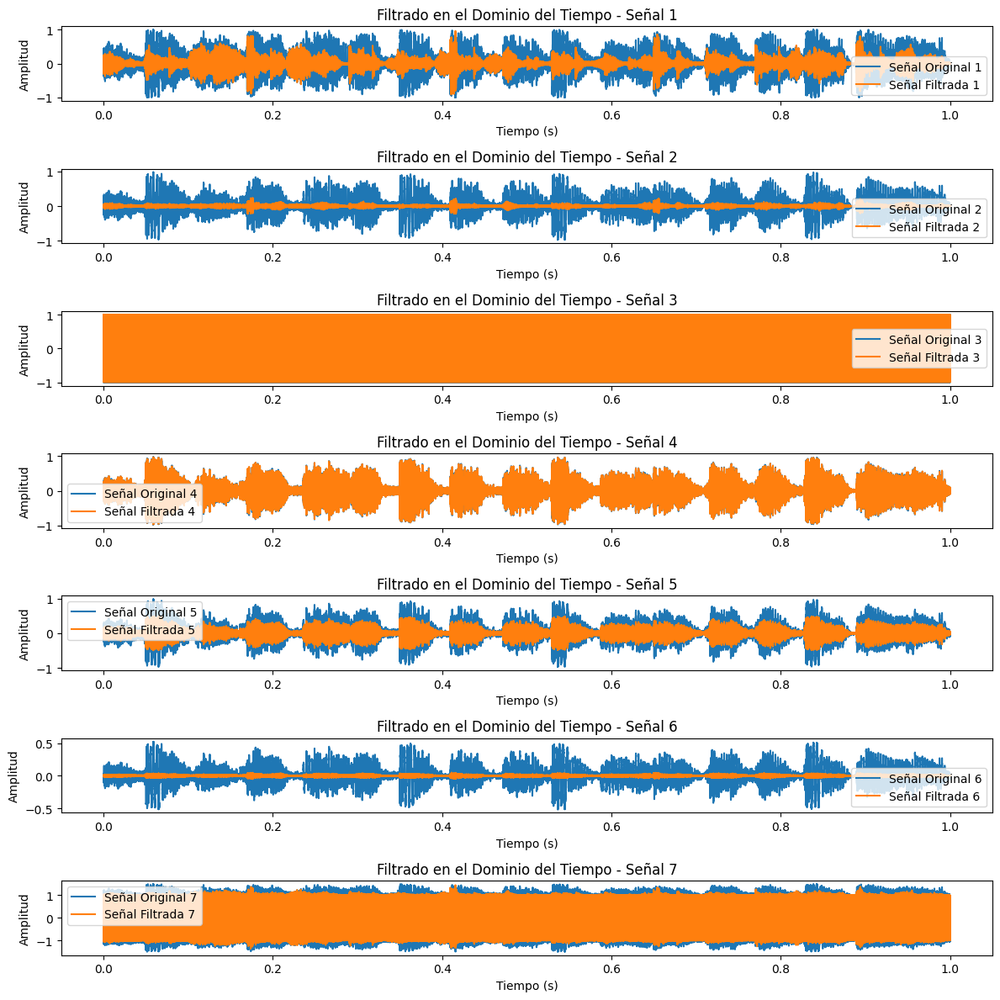

El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.


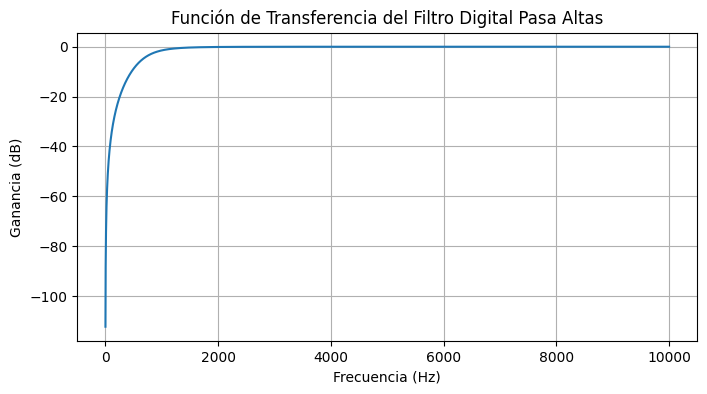

In [62]:
from scipy.signal import butter, lfilter, freqz

# Función para calcular la respuesta del filtro pasa altas digital
def filtro_digital_pasa_altas(frecuencia_corte, frecuencia_muestreo, orden=2):
    nyquist = 0.5 * frecuencia_muestreo
    frecuencia_normalizada = frecuencia_corte / nyquist
    b, a = butter(orden, frecuencia_normalizada, btype='high', analog=False)
    return b, a

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte, frecuencia_muestreo, tiempo, frecuencia, dominio='tiempo'):
    if dominio == 'tiempo':
        # Crear el filtro digital pasa altas
        b, a = filtro_digital_pasa_altas(frecuencia_corte, frecuencia_muestreo)
        # Filtrar la señal en el dominio del tiempo
        signal_filtrada = lfilter(b, a, signal)
        return signal_filtrada, b, a
    elif dominio == 'frecuencia':
        raise NotImplementedError("El filtrado digital directo en el dominio de la frecuencia no está implementado.")

# Definición de parámetros iniciales
frecuencia_corte = 800  # Frecuencia de corte (Hz)
frecuencia_muestreo = 20000  # Frecuencia de muestreo (Hz)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/frecuencia_muestreo)  # Use frecuencia_muestreo

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, frecuencia_muestreo, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    try:
        señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte, frecuencia_muestreo, tiempo, frecuencia, dominio='frecuencia')
        señales_frecuencia_filtradas.append(señal_filtrada)
    except NotImplementedError as e:
        print(e)

# Visualización de la función de transferencia del filtro
b, a = filtro_digital_pasa_altas(frecuencia_corte, frecuencia_muestreo)
w, h = freqz(b, a, worN=8000, fs=frecuencia_muestreo)
plt.figure(figsize=(8, 4))
plt.plot(w, 20 * np.log10(abs(h)))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Ganancia (dB)')
plt.title('Función de Transferencia del Filtro Digital Pasa Altas')
plt.grid()
plt.show()


Filtro pasa bandas

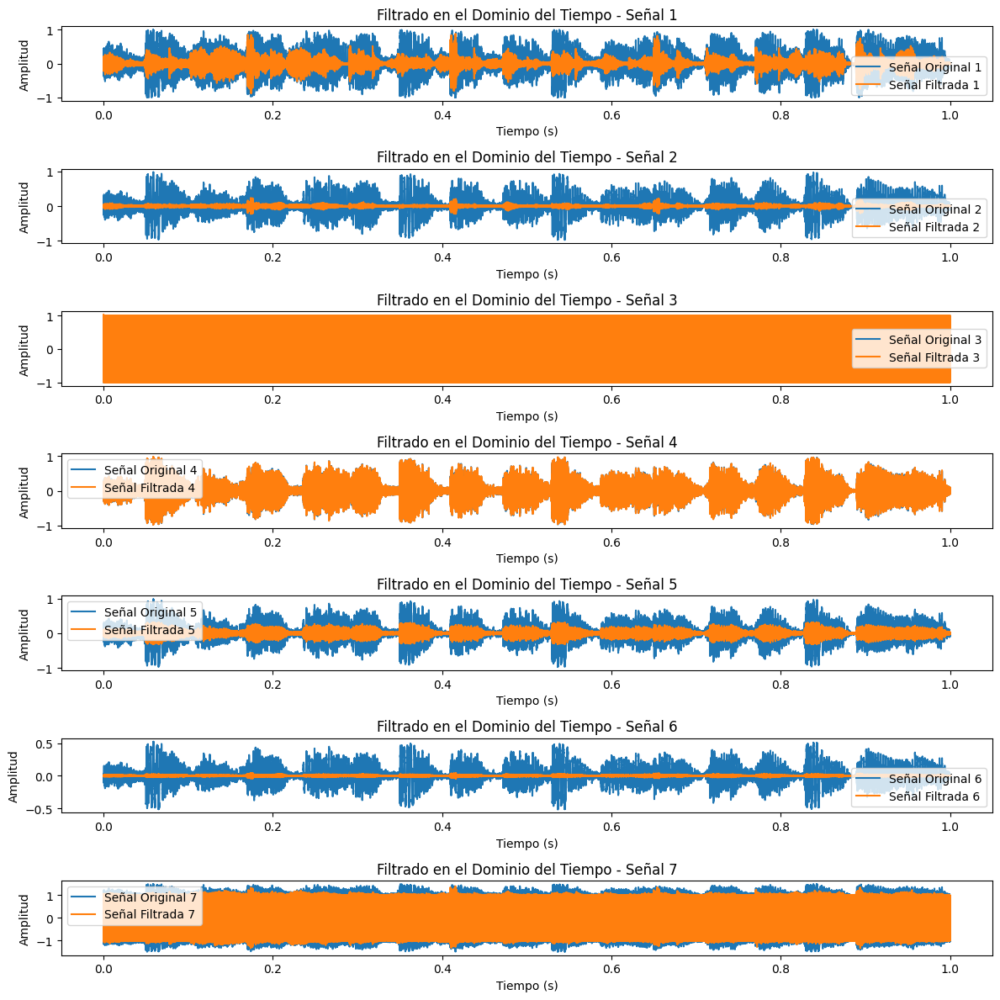

El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.
El filtrado digital directo en el dominio de la frecuencia no está implementado.


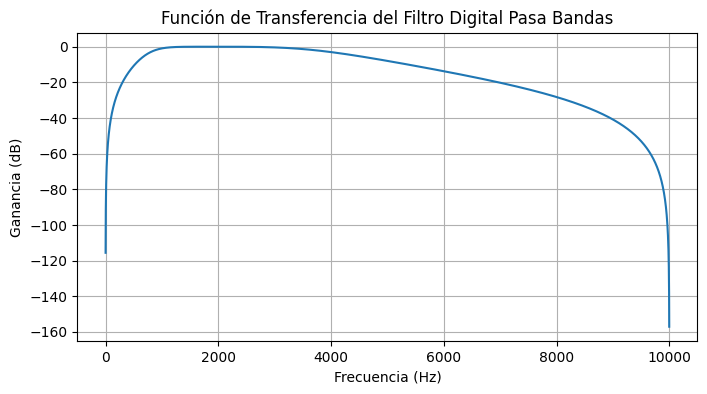

In [65]:
from scipy.signal import butter, lfilter, freqz

# Función para calcular la respuesta del filtro pasa bandas digital
def filtro_digital_pasa_bandas(frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo, orden=2):
    nyquist = 0.5 * frecuencia_muestreo
    frecuencia_normalizada = [frecuencia_corte_baja / nyquist, frecuencia_corte_alta / nyquist]
    b, a = butter(orden, frecuencia_normalizada, btype='band', analog=False)
    return b, a

# Función para aplicar el filtro a una señal en el dominio del tiempo o la frecuencia
def aplicar_filtro(signal, frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo, tiempo, frecuencia, dominio='tiempo'):
    if dominio == 'tiempo':
        # Crear el filtro digital pasa bandas
        b, a = filtro_digital_pasa_bandas(frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo)
        # Filtrar la señal en el dominio del tiempo
        signal_filtrada = lfilter(b, a, signal)
        return signal_filtrada, b, a
    elif dominio == 'frecuencia':
        raise NotImplementedError("El filtrado digital directo en el dominio de la frecuencia no está implementado.")

# Definición de parámetros iniciales
frecuencia_corte_baja = 800   # Frecuencia de corte baja (Hz)
frecuencia_corte_alta = 4000  # Frecuencia de corte alta (Hz)
frecuencia_muestreo = 20000   # Frecuencia de muestreo (Hz)

# Aplicar el filtro a señales en el dominio del tiempo
señales_tiempo = [xc, xf, xt, dx, dx2, dxf, xr]
señales_tiempo_filtradas = []

for señal in señales_tiempo:
    # Calculate the time vector based on the current signal's length
    num_muestras_signal = len(señal)
    tiempo_señal = np.linspace(0, 1, num_muestras_signal)  # Create a time vector specific to each signal

    # Calculate the frequency vector based on the current signal's length
    frecuencia = np.fft.fftfreq(num_muestras_signal, d=1/frecuencia_muestreo)  # Use frecuencia_muestreo

    señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo, tiempo_señal, frecuencia, dominio='tiempo')  # Pass tiempo_señal
    señales_tiempo_filtradas.append(señal_filtrada)

# Visualización de señales en el dominio del tiempo
plt.figure(figsize=(12, 12))
for i, (original, filtrada) in enumerate(zip(señales_tiempo, señales_tiempo_filtradas)):
    plt.subplot(len(señales_tiempo), 1, i + 1)

    # Use tiempo_señal for plotting, which matches the length of the signal
    tiempo_señal = np.linspace(0, 1, len(original)) # Create time vector specific to each signal
    plt.plot(tiempo_señal, original, label=f'Señal Original {i + 1}')
    plt.plot(tiempo_señal, filtrada, label=f'Señal Filtrada {i + 1}')

    plt.xlabel('Tiempo (s)')
    plt.ylabel('Amplitud')
    plt.legend()
    plt.title(f'Filtrado en el Dominio del Tiempo - Señal {i + 1}')
plt.tight_layout()
plt.show()

señales_frecuencia = [Xwc, Xfw, Xwcos, dxw, dxw2, dxwf]
señales_frecuencia_filtradas = []

# Aplicar el filtro a señales en el dominio de la frecuencia
for señal in señales_frecuencia:
    try:
        señal_filtrada, _, _ = aplicar_filtro(señal, frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo, tiempo, frecuencia, dominio='frecuencia')
        señales_frecuencia_filtradas.append(señal_filtrada)
    except NotImplementedError as e:
        print(e)

# Visualización de la función de transferencia del filtro
b, a = filtro_digital_pasa_bandas(frecuencia_corte_baja, frecuencia_corte_alta, frecuencia_muestreo)
w, h = freqz(b, a, worN=8000, fs=frecuencia_muestreo)
plt.figure(figsize=(8, 4))
plt.plot(w, 20 * np.log10(abs(h)))
plt.xlabel('Frecuencia (Hz)')
plt.ylabel('Ganancia (dB)')
plt.title('Función de Transferencia del Filtro Digital Pasa Bandas')
plt.grid()
plt.show()